**TODO**

  1. ~First Generate a new "object_features_vitl14_reg.json" (i.e **"objects_features_featup.json"**) file to get featup object features instead of dinov2_vitl14.~
  2. ~Then change the code below of file ("demo_eval_gdino_FFA.py") to get featup embeddings for the part 2 of the img, part 3 will remain the same.~
  3. Check the adapter weather it needs to be adjusted, for featup features like dinov2_vitl14 gives us 1024 dim of feats whereas, featup gives us 384 feats.
  4. Check the metrics in the evaluation and then compare both of them.

_Note: ~First Check eval resuls of single images that is given~ and then duplicate the script and adjust it for the whole dataset eval results. If getting better results on the single images then go for whole._


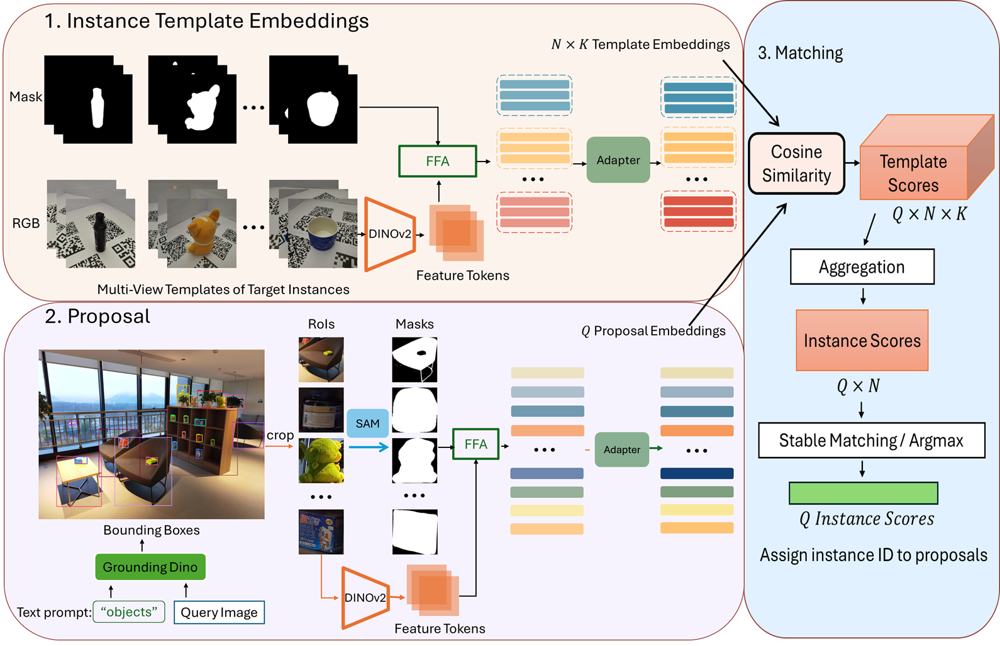

# Generate object_features.json file for Featup

In [3]:
import glob
import json
import math
import os
import re
import numpy as np
import matplotlib.pyplot as plt
from typing import List, Optional
from PIL import Image, ImageFile

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

def find_mask_bbox(mask_array):
    rows = np.any(mask_array, axis=1)
    cols = np.any(mask_array, axis=0)
    rmin, rmax = np.where(rows)[0][[0, -1]]
    cmin, cmax = np.where(cols)[0][[0, -1]]

    return (cmin, rmin, cmax+1, rmax+1)  # PIL uses (left, upper, right, lower)

class InstanceDataset(Dataset):
    def __init__(self, data_dir, dataset, data=None, transform=None, imsize=None):
        self.sample_masks = None
        if dataset == 'Object':

            num_obj = []
            image_dir = []
            mask_dir = []
            count = []

            source_list = sorted(glob.glob(os.path.join(data_dir, '*')))

            for _, source_dir in enumerate(source_list):
                num_obj.append(source_dir.split('/')[-1].split('.')[0])
                image_paths = sorted([p for p in glob.glob(os.path.join(source_dir, 'images', '*'))
                                      if re.search('/*\.(jpg|jpeg|png|gif|bmp|pbm)', str(p))])
                image_dir.extend(image_paths)
                mask_paths = sorted([p for p in glob.glob(os.path.join(source_dir, 'masks', '*'))
                                     if re.search('/*\.(jpg|jpeg|png|gif|bmp|pbm)', str(p))])
                mask_dir.extend(mask_paths)
                count.append(len(image_paths))

            cfg = dict()
            cfg['dataset'] = dataset
            cfg['data_dir'] = data_dir
            cfg['image_dir'] = image_dir
            cfg['mask_dir'] = mask_dir
            cfg['obj_name'] = num_obj  # object lists for Object
            cfg['length'] = count

            self.samples = cfg['image_dir']
            self.sample_masks = cfg['mask_dir']

        elif dataset == 'Scene':

            num_scene = []
            image_dir = []
            proposals = []
            count = []

            with open(os.path.join(os.path.dirname(data_dir),
                                   'proposals_on_' + data_dir.split('/')[-1] + '.json')) as f:
                proposal_json = json.load(f)

            source_list = sorted(glob.glob(os.path.join(data_dir, '*')))

            for idx, source_dir in enumerate(source_list):
                scene_name = source_dir.split('/')[-1]
                num_scene.append(scene_name)

                image_paths = sorted([p for p in glob.glob(os.path.join(source_dir, '*'))
                                      if re.search('/*\.(jpg|jpeg|png|gif|bmp|pbm)', str(p))])
                image_dir.extend(image_paths)
                count.append(len(image_paths))
                proposals.extend(proposal_json[scene_name])

            cfg = dict()
            cfg['dataset'] = dataset
            cfg['data_dir'] = data_dir
            cfg['image_dir'] = image_dir
            cfg['proposals'] = proposals
            cfg['scene_name'] = num_scene  # scene list for Scene
            cfg['length'] = count

            self.samples = cfg['image_dir']

        else: # for demo scene image
            with open(os.path.join(data_dir, 'proposals_on_' + dataset + '.json')) as f:
                proposal_json = json.load(f)

            cfg = dict()
            cfg['dataset'] = dataset
            cfg['data_dir'] = data_dir
            cfg['image_dir'] = None
            cfg['proposals'] = proposal_json
            cfg['scene_name'] = [dataset]  # scene list for Scene
            cfg['length'] = [len(data)]

            self.samples = data


        self.cfg = cfg
        self.transform = transform
        self.imsize = imsize

    def __len__(self):
        return len(self.samples)

    def get_resized_mask(self, mask):
        # mask_size = self.imsize // 14
        # resized_mask = mask.resize((mask_size, mask_size), Image.BILINEAR)
        resized_mask_numpy = np.array(mask)
        # show resized mask
        # plt.imshow(resized_mask_numpy)
        # plt.show()
        resized_mask_numpy = resized_mask_numpy / 255.0
        tensor_mask = torch.from_numpy(resized_mask_numpy.astype(np.float32))
        tensor_mask[tensor_mask > 0.5] = 1.0
        tensor_mask = tensor_mask.unsqueeze(0).long()  # .to(self.device)
        if tensor_mask.sum() == 0:
            tensor_mask = torch.ones_like(tensor_mask)
        return tensor_mask

    def __getitem__(self, index):
        path = self.samples[index]
        label = int(path.split('/')[-3][:3])
        # if self.sample_masks:
        mask_path = self.sample_masks[index]
        mask = Image.open(mask_path)
        mask = mask.convert('L')
        ImageFile.LOAD_TRUNCATED_IMAGES = True

        with open(path, 'rb') as f:
            img = Image.open(f)
            img = img.convert('RGB')

        w, h = img.size

        if (self.imsize is not None) and (min(w, h) > self.imsize):
            img.thumbnail((self.imsize, self.imsize), Image.LANCZOS)
            mask.thumbnail((self.imsize, self.imsize), Image.BILINEAR)
        else:
            new_w = math.ceil(w / 14) * 14
            new_h = math.ceil(h / 14) * 14
            img = img.resize((new_w, new_h), Image.LANCZOS)
            mask = mask.resize((new_w, new_h), Image.BILINEAR)

        if self.transform is not None:
            img = self.transform(img)
            mask = self.get_resized_mask(mask)

        # print("\nHERE >>>", img.shape, mask.shape)
        return img, label, mask

In [4]:
# get_object_features_via_FFA.py
# To Generate object_features_vitl14_reg.json

import numpy as np
import torch
from torch import nn
import torchvision
from PIL import Image
from matplotlib import pyplot as plt
import os
import json
from tqdm import trange, tqdm
from matplotlib import colors
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
import time
import math
from featup.util import norm, unnorm, pca, remove_axes

# Function to find the bounding box of the non-zero regions in the mask
def find_mask_bbox(mask_array):
    rows = np.any(mask_array, axis=1)
    cols = np.any(mask_array, axis=0)
    rmin, rmax = np.where(rows)[0][[0, -1]]
    cmin, cmax = np.where(cols)[0][[0, -1]]

    return (cmin, rmin, cmax+1, rmax+1)  # PIL uses (left, upper, right, lower)

img_size = 448
# Define transformations to be applied to the images
# used before function get_object_features_via_dataloader
# transform = transforms.Compose([
#             transforms.Resize((img_size, img_size), interpolation=transforms.InterpolationMode.BICUBIC),
#             transforms.ToTensor(),
#             transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
#         ])

transform = transforms.Compose([
        transforms.Resize((img_size, img_size)),
        transforms.CenterCrop((img_size, img_size)),
        transforms.ToTensor(),
        norm
    ])

object_dataset = InstanceDataset(data_dir='C:\dataset\InsDet-FULL\Objects', dataset='Object',transform=transform, imsize=img_size)
object_dataset.__len__()

2400

In [5]:
# use dino v2 to extract features
# encoder = torch.hub.load('facebookresearch/dinov2', 'dinov2_vitl14_reg')
# encoder.to('cuda')
# encoder.eval()

upsampler=torch.hub.load("mhamilton723/FeatUp", 'dinov2').to('cuda').eval()

Using cache found in C:\Users\divya/.cache\torch\hub\mhamilton723_FeatUp_main
c:\Users\divya\AppData\Local\Programs\Python\Python310\lib\site-packages\featup\featurizers\dinov2\layers\swiglu_ffn.py:51: UserWarning: xFormers is not available (SwiGLU)
  warnings.warn("xFormers is not available (SwiGLU)")
c:\Users\divya\AppData\Local\Programs\Python\Python310\lib\site-packages\featup\featurizers\dinov2\layers\attention.py:33: UserWarning: xFormers is not available (Attention)
  warnings.warn("xFormers is not available (Attention)")
c:\Users\divya\AppData\Local\Programs\Python\Python310\lib\site-packages\featup\featurizers\dinov2\layers\block.py:40: UserWarning: xFormers is not available (Block)
  warnings.warn("xFormers is not available (Block)")
Using cache found in C:\Users\divya/.cache\torch\hub\facebookresearch_dinov2_main
C:\Users\divya/.cache\torch\hub\facebookresearch_dinov2_main\dinov2\layers\swiglu_ffn.py:51: UserWarning: xFormers is not available (SwiGLU)
  warnings.warn("xForme

In [6]:
object_dataset = object_dataset
img_size=448 
"""
@param output_dir: save dirs
@param json_filename: save the features
@param object_dataset: should have transformed images and masks
@param model: DINOv2 model
@param img_size: 224, 336 or 448
@return:
"""
# Capture the start time
start_time = time.time()
batch_size = 3  # Define the batch size

# Initialize lists to hold a batch of images and masks
dataloader = DataLoader(object_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
print(dataloader.__len__())

1200


In [ ]:
with torch.no_grad():
        imgs, _, masks = next(iter(dataloader))
        hr_feats = upsampler(imgs.to('cuda'))                   # Shape: (B, 384, 512, 512)
        hr_feats = torch.nn.functional.interpolate(hr_feats, imgs.shape[2:], mode="bilinear") # Shape: (B, 384, 448, 448)
        lr_feats = upsampler.model(imgs.to('cuda'))

        hr_feats = hr_feats * masks.permute(0, 2, 3, 1)
        hr_feats = hr_feats.permute(0, 3, 1, 2)
        [hr_feats], _ = pca([hr_feats], dim=9)

        lr_feats = lr_feats * masks.permute(0, 2, 3, 1)
        lr_feats = lr_feats.permute(0, 3, 1, 2)
        [lr_feats], _ = pca([lr_feats], dim=9)
        print(f"\n{imgs.shape=} || {masks.shape=} || {lr_feats.shape} || {hr_feats.shape}")
        
        # print(f"\n{feats.shape=} & {og_img.shape=}")
        fig, ax = plt.subplots(1, 3, figsize=(5, 15))
        ax[0].imshow(unnorm(imgs)[0].permute(1,2,0).detach().cpu())
        ax[1].imshow(lr_feats[0, :3].permute(1,2,0).detach().cpu())
        ax[1].imshow(hr_feats[0, :3].permute(1,2,0).detach().cpu())
        plt.tight_layout()
        plt.show()

In [7]:
object_features = []

with torch.no_grad():
    for imgs, _, masks in tqdm(dataloader):
        imgs, _, masks = next(iter(dataloader))
        # print(f"\n{imgs.shape=}, {masks.shape=}") # Shape: (B, 3, 448, 448) || (B, 1, 448, 448)

        # ffa_features = get_features_via_batch_tensor(imgs, masks, model, img_size=img_size) # replace this
        hr_feats = upsampler(imgs.to('cuda'))                   # Shape: (B, 384, 512, 512)
        hr_feats = torch.nn.functional.interpolate(hr_feats, imgs.shape[2:], mode="bilinear") # Shape: (B, 384, 448, 448)
        # lr_feats = upsampler.model(imgs.to('cuda'))
 
        ## CODE FOR PLOTTING
        # hr_feats = hr_feats * masks.permute(0, 2, 3, 1)
        # hr_feats = hr_feats.permute(0, 3, 1, 2)
        # [hr_feats], _ = pca([hr_feats], dim=9)

        # lr_feats = lr_feats * masks.permute(0, 2, 3, 1)
        # lr_feats = lr_feats.permute(0, 3, 1, 2)
        # [lr_feats], _ = pca([lr_feats], dim=9)
        # print(f"\n{imgs.shape=} || {masks.shape=} || {lr_feats.shape} || {hr_feats.shape}")
        
        # # print(f"\n{feats.shape=} & {og_img.shape=}")
        # fig, ax = plt.subplots(1, 3, figsize=(5, 15))
        # ax[0].imshow(unnorm(imgs)[0].permute(1,2,0).detach().cpu())
        # ax[1].imshow(lr_feats[0, :3].permute(1,2,0).detach().cpu())
        # ax[1].imshow(hr_feats[0, :3].permute(1,2,0).detach().cpu())
        # plt.tight_layout()
        # plt.show()
        
        hr_feats=hr_feats.permute(0,2,3,1).detach().cpu()           # Shape: (B, 448, 448, 384)
        h, w=imgs.shape[2:]
        padding_feats=torch.nn.Parameter(torch.randn(1, h, w, 128)) # Shape: (B, 448, 448, 128)
        new_feats=torch.cat((hr_feats, padding_feats), dim=-1)      # Shape: (B, 448, 448, 512)
        ffa_features = (new_feats * masks.permute(0, 2, 3, 1)).sum(dim=(1, 2)) / masks.sum(dim=(1, 2, 3)).unsqueeze(-1) # Shape: (1, 384)
        object_features.append(ffa_features) # Shape: (B, 512)

object_features = torch.cat(object_features, dim=0)

feat_dict = dict()
feat_dict['features'] = object_features.detach().cpu().tolist()
end_time = time.time()

output_dir = 'D:/CODE/NIDS-Net/feats'
json_filename = 'object_features_pad_featup.json'

# Calculate and print the total time
print(f"Total running time: {end_time - start_time} seconds")
with open(os.path.join(output_dir, json_filename), 'w') as f:
    json.dump(feat_dict, f)

print(object_features.shape) # (2400, 384)

This below is "demo_eval_gdino_FFA.py" file code, which excutes one image "test002.jpeg" i.e that img used in the archi, It generates the scene features of the images and creates rois and cropped masks, and compute its similarity with the preexisting templates of object features saved in "object_features_vitl14_reg.json" which has object features from dinov2, and later does the matching and stores the result in json file. Then the Evaluation is done using saved GT and this stored instances in json file for this img, and then results are displayed.


- The "object_features_vitl14_reg.json" file saves the Part 1 from the above image
- We Calculate Part 2 and the generate similarity btw Part 1 and 2 for getting classification of the object and the assign instance ID to the proposals
- GT Saved hai all aur singles ke bhi (to iska tension nahi hai)



# Single Image test on NIDSxFEATUP

In [ ]:
!pip install -q git+https://github.com/mhamilton723/FeatUp

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 377.0/377.0 kB 14.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 833.3/833.3 kB 37.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 21.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 866.2/866.2 kB 34.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 41.6 MB/s eta 0:00:00


In [ ]:
!git clone https://github.com/YoungSean/NIDS-Net.git

Cloning into 'NIDS-Net'...
remote: Enumerating objects: 559, done.
remote: Counting objects: 100% (110/110), done.
remote: Compressing objects: 100% (68/68), done.
remote: Total 559 (delta 63), reused 82 (delta 42), pack-reused 449 (from 1)
Receiving objects: 100% (559/559), 103.94 MiB | 21.17 MiB/s, done.
Resolving deltas: 100% (241/241), done.


In [ ]:
%cd NIDS-Net/

/content/NIDS-Net


In [ ]:
!pip install -q -r requirements.txt

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.0/43.0 kB 2.3 MB/s eta 0:00:00


In [ ]:
!python setup.py install

I0826 19:49:26.220334 132409338937344 dist.py:986] running install
/usr/local/lib/python3.10/dist-packages/setuptools/_distutils/cmd.py:66: SetuptoolsDeprecationWarning: setup.py install is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` directly.
        Instead, use pypa/build, pypa/installer or other
        standards-based tools.

        See https://blog.ganssle.io/articles/2021/10/setup-py-deprecated.html for details.
        ********************************************************************************

!!
  self.initialize_options()
I0826 19:49:26.317737 132409338937344 dist.py:986] running build
I0826 19:49:26.317934 132409338937344 dist.py:986] running build_py
I0826 19:49:26.361238 132409338937344 dir_util.py:70] creating build
I0826 19:49:26.361516 132409338937344 dir_util.py:70] creating build/lib
I0826 19:49:26.361709 132409338937344 dir_util.py:70] creating build/lib/data

In [ ]:
!python -m pip -q install 'git+https://github.com/facebookresearch/detectron2.git'

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.2/78.2 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 47.2 MB/s eta 0:00:00


In [ ]:
!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
!mkdir ckpts/sam_weights
!mv sam_vit_h_4b8939.pth ckpts/sam_weights

--2024-08-26 19:56:08--  https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 3.163.189.14, 3.163.189.51, 3.163.189.108, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|3.163.189.14|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2564550879 (2.4G) [binary/octet-stream]
Saving to: ‘sam_vit_h_4b8939.pth’

sam_vit_h_4b8939.pt 100%[===================>]   2.39G   232MB/s    in 15s     

2024-08-26 19:56:23 (165 MB/s) - ‘sam_vit_h_4b8939.pth’ saved [2564550879/2564550879]



In [ ]:
!pip install -q numpy==1.26.1 supervision==0.18.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.2/61.2 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.2/18.2 MB 63.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.7/86.7 kB 6.2 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


final text_encoder_type: bert-base-uncased


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

groundingdino_swint_ogc.pth:   0%|          | 0.00/694M [00:00<?, ?B/s]

Model loaded from /root/.cache/huggingface/hub/models--ShilongLiu--GroundingDINO/snapshots/a94c9b567a2a374598f05c584e96798a170c56fb/groundingdino_swint_ogc.pth 
 => _IncompatibleKeys(missing_keys=[], unexpected_keys=['label_enc.weight', 'bert.embeddings.position_ids'])


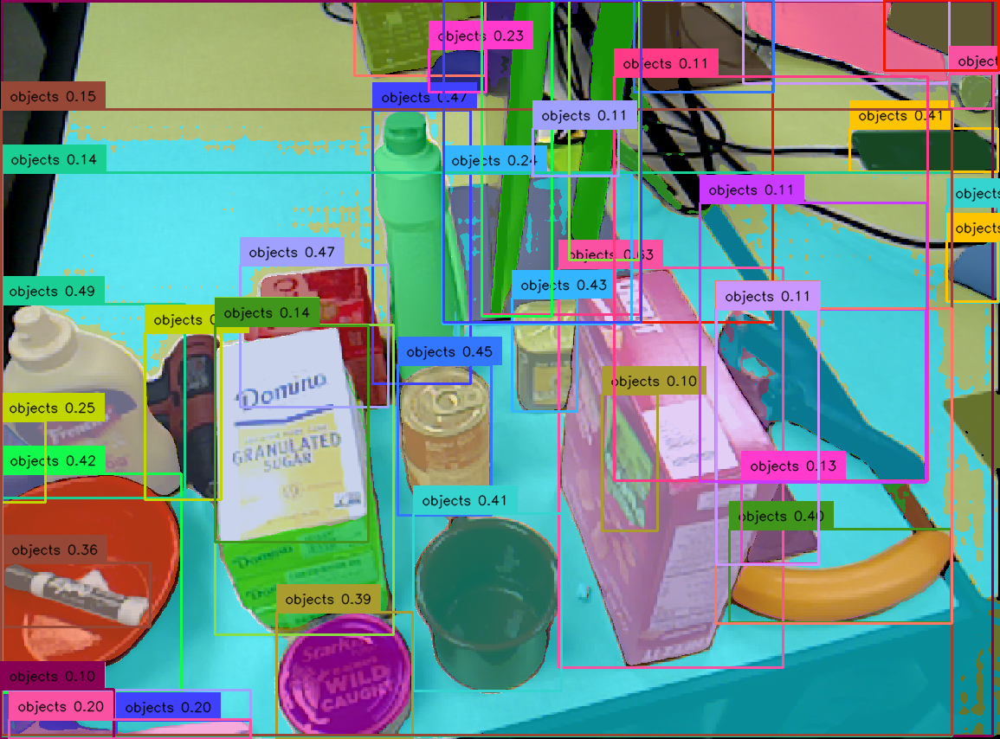

In [ ]:
from absl import app, logging
from PIL import Image as PILImg
from robokit.utils import annotate, overlay_masks
from robokit.ObjDetection import GroundingDINOObjectPredictor, SegmentAnythingPredictor
from IPython.display import display

def test_gsam(image_path):
    # Path to the input image
    text_prompt = 'objects'

    try:
        logging.info("Initialize object detectors")
        gdino = GroundingDINOObjectPredictor()
        SAM = SegmentAnythingPredictor()

        logging.info("Open the image and convert to RGB format")
        image_pil = PILImg.open(image_path).convert("RGB")

        logging.info("GDINO: Predict bounding boxes, phrases, and confidence scores")
        bboxes, phrases, gdino_conf = gdino.predict(image_pil, text_prompt)

        logging.info("GDINO post processing")
        w, h = image_pil.size # Get image width and height
        # Scale bounding boxes to match the original image size
        image_pil_bboxes = gdino.bbox_to_scaled_xyxy(bboxes, w, h)

        logging.info("SAM prediction")
        image_pil_bboxes, masks = SAM.predict(image_pil, image_pil_bboxes)

        logging.info("Annotate the scaled image with bounding boxes, confidence scores, and labels, and display")
        bbox_annotated_pil = annotate(overlay_masks(image_pil, masks), image_pil_bboxes, gdino_conf, phrases)

        display(bbox_annotated_pil)

    except Exception as e:
        # Handle unexpected errors
        print(f"An unexpected error occurred: {e}")

test_gsam('imgs/clutter-test.png')

In [ ]:
# demo_eval_gdino_FFA.py
import time
import argparse
import cv2
import glob
import json
import logging
import os
import sys
import random
import numpy as np
import matplotlib.pyplot as plt
from typing import List, Optional

import torch
from torch import nn
import torch.backends.cudnn as cudnn
from torchvision import transforms as pth_transforms
import torchvision.transforms as T

sys.path.append("../detectron2")
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances

sys.path.append(".")
from utils.visualizer import ColorMode, Visualizer
from utils.instance_det_dataset import RealWorldDataset
from utils.inference_utils import compute_similarity, stableMatching, get_bbox_masks_from_gdino_sam, \
    get_object_proposal, getColor, create_instances, nms, apply_nms, get_features
from tqdm import trange
from adapter import ModifiedClipAdapter, WeightAdapter
from utils.img_utils import get_masked_image

output_dir = '/content/drive/MyDrive/Research/'
json_filename = 'object_features.json'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

upsampler = torch.hub.load("mhamilton723/FeatUp", 'dinov2')
upsampler.to('cuda')

with open(os.path.join(output_dir, json_filename), 'r') as f:
    feat_dict = json.load(f)

object_features = torch.Tensor(feat_dict['features']).to(device)
object_features = nn.functional.normalize(object_features, dim=1, p=2)
print("object_features: ", object_features.shape) # Shape (2400, 1024) => (2400, 384)

Downloading: "https://github.com/mhamilton723/FeatUp/zipball/main" to /root/.cache/torch/hub/main.zip
Downloading: "https://github.com/facebookresearch/dinov2/zipball/main" to /root/.cache/torch/hub/main.zip
Downloading: "https://dl.fbaipublicfiles.com/dinov2/dinov2_vits14/dinov2_vits14_pretrain.pth" to /root/.cache/torch/hub/checkpoints/dinov2_vits14_pretrain.pth
100%|██████████| 84.2M/84.2M [00:00<00:00, 166MB/s]
Downloading: "https://marhamilresearch4.blob.core.windows.net/feature-upsampling-public/pretrained/dinov2_jbu_stack_cocostuff.ckpt" to /root/.cache/torch/hub/checkpoints/dinov2_jbu_stack_cocostuff.ckpt
100%|██████████| 2.04M/2.04M [00:00<00:00, 3.50MB/s]


object_features:  torch.Size([2400, 384])


In [ ]:
# In[10]:
from absl import app, logging
from PIL import Image as PILImg
from robokit.ObjDetection import GroundingDINOObjectPredictor, SegmentAnythingPredictor

# Path to the input image
imsize = 448
tag = "mask"  # bbox
img_id = 2
image_path = "test_data/test_1/test_"+str(img_id).zfill(3)+".jpg" # << Since single image eval so load that image
test_path = "test_data/test_1/test_"+str(img_id).zfill(3)+".jpg"
output_dir = "exps/demo0501_" + str(imsize) + "_" + tag

logging.info("Initialize object detectors")
gdino = GroundingDINOObjectPredictor(use_vitb=False, threshold=0.15)
SAM = SegmentAnythingPredictor(vit_model="vit_h")

logging.info("Open the image and convert to RGB format")
image_pil = PILImg.open(image_path).convert("RGB")

# #### 1. Get object proposals with Grounded-SAM
logging.info("1. Get object proposals with Grounded-SAM")
accurate_bboxs, masks = get_bbox_masks_from_gdino_sam(image_path, gdino, SAM, text_prompt='objects', visualize=True)
print(accurate_bboxs.shape)

final text_encoder_type: bert-base-uncased
Model loaded from /root/.cache/huggingface/hub/models--ShilongLiu--GroundingDINO/snapshots/a94c9b567a2a374598f05c584e96798a170c56fb/groundingdino_swint_ogc.pth 
 => _IncompatibleKeys(missing_keys=[], unexpected_keys=['label_enc.weight', 'bert.embeddings.position_ids'])
torch.Size([22, 4])


In [ ]:
from utils.inference_utils import FFA_preprocess, get_foreground_mask
# #### 2. Crop proposals from the high-resolution version
logging.info("2. Crop proposals from the high-resolution version")
# In[11]:

start_time = time.time()
scene_features_list = []
proposals_list = []
scene_name_list = []
mask = masks.cpu().numpy()
accurate_bboxs = accurate_bboxs.cpu().numpy()
scene_name = os.path.basename(image_path).split('.')[0]
scene_name_list.append(scene_name)
rois, sel_rois, cropped_imgs, cropped_masks = get_object_proposal(test_path, accurate_bboxs, masks, tag=tag, ratio=0.25, save_rois=False, output_dir=output_dir, save_proposal=False)
scene_features = []

In [ ]:
with torch.no_grad():
  for i in trange(len(cropped_imgs)):

    # BOTH ARE RAW
    img = cropped_imgs[i]
    mask = cropped_masks[i]

    # ffa_feature= get_features([img], [mask], encoder,device=device, img_size=imsize) # Dino mese features nikal ke avg
    preprocessed_imgs = FFA_preprocess([img], img_size=imsize).to(device)
    # mask_size = img_size // 14
    print(f"\n{preprocessed_imgs.shape=}")
    masks = get_foreground_mask([mask], mask_size=imsize).to(device)  # Shape: (1, 1, H, W)

    hr_feats = upsampler(preprocessed_imgs)                   # Shape: (1, 384, 512, 512)
    hr_feats = torch.nn.functional.interpolate(hr_feats, masks.shape[2:], mode="bilinear") # Shape: (1, 384, H, W)
    print(f"{hr_feats.shape=}")
    hr_feats = hr_feats.permute(0,2,3,1) # Shape: (1, H, W, 384)

    # h, w = masks.shape[2:]
    # padding_tensor = nn.Parameter(torch.randn(1, h, w, 128))  # Shape: (1, H, W, 128)
    # hr_feats = torch.cat((hr_feats, padding_tensor), dim=-1)  # Shape: (1, H, W, 512)

    # TODO: Add MRL (Matryoshka Representation Learning) to hr_feats and reduce the dimensions and then avg it out
    ffa_feature = (hr_feats * masks.permute(0, 2, 3, 1)).sum(dim=(1, 2)) / masks.sum(dim=(1, 2, 3)).unsqueeze(-1) # Shape: (1, 384) > (1, 512)
    print(f"{ffa_feature.shape=}")

    # object_features.append(ffa_features) # Shape: (B, 384)
    # with torch.no_grad():
    #     if use_adapter:
    #         ffa_feature = adapter(ffa_feature)
    scene_features.append(ffa_feature)

  0%|          | 0/22 [00:00<?, ?it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])


  5%|▍         | 1/22 [00:00<00:08,  2.35it/s]

hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


  9%|▉         | 2/22 [00:00<00:07,  2.73it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 14%|█▎        | 3/22 [00:01<00:06,  2.85it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 18%|█▊        | 4/22 [00:01<00:06,  2.90it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 23%|██▎       | 5/22 [00:01<00:05,  2.91it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 27%|██▋       | 6/22 [00:02<00:05,  2.91it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 32%|███▏      | 7/22 [00:02<00:05,  2.93it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 36%|███▋      | 8/22 [00:02<00:04,  2.91it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 41%|████      | 9/22 [00:03<00:04,  2.94it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 45%|████▌     | 10/22 [00:03<00:04,  2.91it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 50%|█████     | 11/22 [00:03<00:03,  2.96it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 55%|█████▍    | 12/22 [00:04<00:03,  2.94it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 59%|█████▉    | 13/22 [00:04<00:03,  2.92it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 64%|██████▎   | 14/22 [00:04<00:02,  2.94it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 68%|██████▊   | 15/22 [00:05<00:02,  2.96it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 73%|███████▎  | 16/22 [00:05<00:02,  2.96it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 77%|███████▋  | 17/22 [00:05<00:01,  2.94it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 82%|████████▏ | 18/22 [00:06<00:01,  2.93it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 86%|████████▋ | 19/22 [00:06<00:01,  2.94it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 91%|█████████ | 20/22 [00:06<00:00,  2.90it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


 95%|█████████▌| 21/22 [00:07<00:00,  2.91it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])


100%|██████████| 22/22 [00:07<00:00,  2.91it/s]

preprocessed_imgs.shape=torch.Size([1, 3, 448, 448])
hr_feats.shape=torch.Size([1, 384, 448, 448])
ffa_feature.shape=torch.Size([1, 384])
Total running time: 8.801042795181274 seconds


In [ ]:

scene_features = torch.cat(scene_features, dim=0)
scene_features = nn.functional.normalize(scene_features, dim=1, p=2)

scene_features_list.append(scene_features)
proposals_list.append(sel_rois)

# Capture the end time
end_time = time.time()

# Calculate and print the total time
print(f"Total running time: {end_time - start_time} seconds")

# image_height, image_width = raw_image.shape[:-1]
scene_name = os.path.basename(test_path).split('.')[0]

In [ ]:
def calculate_area(bbox):
    x1, y1, x2, y2 = bbox
    return (x2 - x1) * (y2 - y1)

In [ ]:
num_object = 100 # len(object_dataset.cfg['obj_name'])
num_example = len(object_features) // num_object

results = []

for idx, scene_feature in enumerate(scene_features_list):
    sim_mat = compute_similarity(object_features, scene_feature)
    sim_mat = sim_mat.view(len(scene_feature), num_object, num_example)
    sims, _ = torch.max(sim_mat, dim=2)  # choose max score over profile examples of each object instance
    max_ins_sim, initial_result = torch.max(sims, dim=1)

    proposals = proposals_list[idx]
    num_proposals = len(proposals)

    ########################################## Stable Matching Strategy ##########################################
    do_matching = True
    if do_matching:
        # ------------ ranking and sorting ------------
        # Initialization
        sel_obj_ids = [str(v) for v in list(np.arange(num_object))]  # ids for selected obj
        sel_roi_ids = [str(v) for v in list(np.arange(len(scene_feature)))]  # ids for selected roi

        # Padding
        max_len = max(len(sel_roi_ids), len(sel_obj_ids))
        sel_sims_symmetric = torch.ones((max_len, max_len)) * -1
        sel_sims_symmetric[:len(sel_roi_ids), :len(sel_obj_ids)] = sims.clone()

        pad_len = abs(len(sel_roi_ids) - len(sel_obj_ids))
        if len(sel_roi_ids) > len(sel_obj_ids):
            pad_obj_ids = [str(i) for i in range(num_object, num_object + pad_len)]
            sel_obj_ids += pad_obj_ids
        elif len(sel_roi_ids) < len(sel_obj_ids):
            pad_roi_ids = [str(i) for i in range(len(sel_roi_ids), len(sel_roi_ids) + pad_len)]
            sel_roi_ids += pad_roi_ids

        # ------------ stable matching ------------
        matchedMat = stableMatching(
            sel_sims_symmetric.detach().data.cpu().numpy())  # predMat is raw predMat
        predMat_row = np.zeros_like(
            sel_sims_symmetric.detach().data.cpu().numpy())  # predMat_row is the result after stable matching
        Matches = dict()
        for i in range(matchedMat.shape[0]):
            tmp = matchedMat[i, :]
            a = tmp.argmax()
            predMat_row[i, a] = tmp[a]
            Matches[sel_roi_ids[i]] = sel_obj_ids[int(a)]
        print("Done!")

        # ------------ thresholding ------------
        preds = Matches.copy()

        # ------------ save per scene results ------------

        for k, v in preds.items():
            if int(k) >= num_proposals:  # since the number of proposals is less than the number of object features
                break

            result = dict()
            result['image_id'] = proposals[int(k)]['image_id']
            result['category_id'] = int(v)
            result['bbox'] = proposals[int(k)]['bbox']
            result['area'] = calculate_area(proposals[int(k)]['bbox'])
            result['score'] = float(sims[int(k), int(v)])
            result['image_width'] = proposals[int(k)]['image_width']
            result['image_height'] = proposals[int(k)]['image_height']
            result['scale'] = proposals[int(k)]['scale']
            results.append(result)
    else:
        THRESHOLD_OBJECT_SCORE = 0.6
        for i in range(num_proposals):
            if float(max_ins_sim[i]) < THRESHOLD_OBJECT_SCORE:
                continue
            result = dict()
            result['image_id'] = proposals[i]['image_id']
            result['category_id'] = initial_result[i].item()
            result['bbox'] = proposals[i]['bbox']
            result['area'] = calculate_area(proposals[i]['bbox'])
            result['score'] = float(max_ins_sim[i])
            result['image_width'] = proposals[i]['image_width']
            result['image_height'] = proposals[i]['image_height']
            result['scale'] = proposals[i]['scale']
            results.append(result)


    # print("Done!")

Done!
Done!


In [ ]:
results

[{'image_id': 2,
  'category_id': 31,
  'bbox': [973, 977, 104, 66],
  'score': 0.7191535234451294,
  'image_width': 2048,
  'image_height': 1536,
  'scale': 4},
 {'image_id': 2,
  'category_id': 39,
  'bbox': [328, 970, 111, 62],
  'score': 0.8228633403778076,
  'image_width': 2048,
  'image_height': 1536,
  'scale': 4},
 {'image_id': 2,
  'category_id': 51,
  'bbox': [726, 805, 85, 83],
  'score': 0.8515036702156067,
  'image_width': 2048,
  'image_height': 1536,
  'scale': 4},
 {'image_id': 2,
  'category_id': 57,
  'bbox': [1427, 905, 53, 77],
  'score': 0.8071721196174622,
  'image_width': 2048,
  'image_height': 1536,
  'scale': 4},
 {'image_id': 2,
  'category_id': 23,
  'bbox': [1214, 836, 38, 64],
  'score': 0.7227836847305298,
  'image_width': 2048,
  'image_height': 1536,
  'scale': 4},
 {'image_id': 2,
  'category_id': 44,
  'bbox': [1366, 417, 79, 107],
  'score': 0.8861088156700134,
  'image_width': 2048,
  'image_height': 1536,
  'scale': 4},
 {'image_id': 2,
  'category

In [ ]:
# ### Save Results

# In[8]:


# save final results
with open(os.path.join("coco_instances_results.json"), "w") as f:
    json.dump(results, f)

predictions = dict(
    [(k, {'image_id': -1, 'instances': []}) for k in range(len(scene_name_list))])
for idx in range(len(results)):
    id = results[idx]['image_id']
    predictions[scene_name_list.index('test_' + str(id).zfill(3))]['image_id'] = id

    predictions[scene_name_list.index('test_' + str(id).zfill(3))]['instances'].append(results[idx])

torch.save(predictions, os.path.join("instances_predictions.pth"))

print('Done!')

Done!


In [ ]:
# ### Visualization

# In[9]:

# Random custom colors with a fixed random seed
random.seed(77)
thing_colors = []
for i in range(100):
    thing_colors.append(getColor())


# In[10]:


# Register Test Data for COCO evaluation
test_path = "./test_data/test_4" # 1 for raw data, 2 for ratio=0.5, 4 for ratio=0.25, 8 for ratio=0.125  # test_4
# test_json = "./test_data/annotations/instances_test_4.json"  # instances_test_4
test_json = "./test_data/annotations/single_image_ground_truth_"+str(img_id)+".json"  # instances_test_4
register_coco_instances("coco_InsDet_test", {}, test_json, test_path)
MetadataCatalog.get("coco_InsDet_test").thing_colors = thing_colors


# In[11]:


pred_dir = os.path.join(output_dir,"predictions")
os.makedirs(pred_dir, exist_ok=True)
test_metadata = MetadataCatalog.get("coco_InsDet_test")
test_dataset_dicts = DatasetCatalog.get("coco_InsDet_test")

idx = scene_name_list.index(scene_name)
# d = test_dataset_dicts[int(scene_name.split('_')[-1])]
d = test_dataset_dicts[0] # idx
img = cv2.imread(d["file_name"])
base_name = os.path.basename(d["file_name"]).split(".")[0]

# visualize GT
visGT = Visualizer(img[:, :, ::-1],
                   metadata=test_metadata,
                   scale=1.0,
                   instance_mode=ColorMode.SEGMENTATION)
vis_gt = visGT.draw_dataset_dict(d)
cv2.imwrite(os.path.join(pred_dir, base_name + "_gt.jpg"),
            vis_gt.get_image()[:, :, ::-1])

True

In [ ]:
# visualize pred
# predictions = torch.load(os.path.join(args.output_dir, "instances_predictions.pth"))
pred = create_instances(predictions[idx]['instances'], img.shape[:2], test_metadata)
keep_ids = apply_nms(pred)  # apply NMS

visPred = Visualizer(img[:, :, ::-1],
                     metadata=test_metadata,
                     scale=1.0,
                     instance_mode=ColorMode.SEGMENTATION)
vis_pred = visPred.draw_instance_predictions(pred.to("cpu"), keep_ids)
cv2.imwrite(os.path.join(pred_dir, base_name + "_pred_SAM+DINOv2.jpg"),
            vis_pred.get_image()[:, :, ::-1])


True

In [ ]:
# =================================================================================================================
# Evaluation Result for single image

from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval

# Load the ground truth COCO dataset
cocoGt = COCO('test_data/annotations/single_image_ground_truth_'+str(img_id)+'.json')

# Load your detection results
cocoDt = cocoGt.loadRes(os.path.join("coco_instances_results.json"))

# Create a COCOeval object by initializing it with the ground truth and detection results
cocoEval = COCOeval(cocoGt, cocoDt, 'bbox')

# Run the evaluation
cocoEval.evaluate()
cocoEval.accumulate()
cocoEval.summarize()

# 'bbox' specifies that we are doing evaluation for bounding box detection.
# You can change it to 'segm' for segmentation tasks.


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.02s).
Accumulating evaluation results...
DONE (t=0.17s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.654
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.692
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.692
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.625
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.654
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.654
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDet

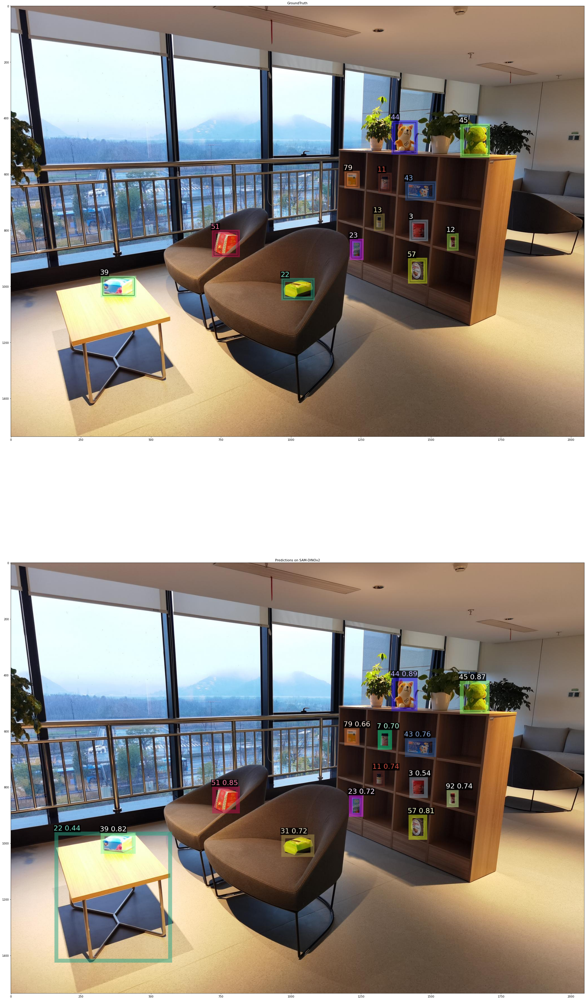

In [ ]:
# In[12]:
fig = plt.figure(figsize=(30,60), dpi=64, facecolor='w', edgecolor='k')
ax = plt.subplot(211)
ax.set_title("GroundTruth")
plt.imshow(vis_gt.get_image()[:, :, :])
ax = plt.subplot(212)
ax.set_title("Predictions on SAM-DINOv2")
plt.imshow(vis_pred.get_image()[:, :, :])
plt.tight_layout()
# plt.savefig('./result_images/InsDet/'+base_name+'_SAM_DINOv2.png', dpi=300)
plt.show()

# OG Single Image Test on NIDS

Downloading: "https://github.com/facebookresearch/dinov2/zipball/main" to /root/.cache/torch/hub/main.zip
Downloading: "https://dl.fbaipublicfiles.com/dinov2/dinov2_vitl14/dinov2_vitl14_reg4_pretrain.pth" to /root/.cache/torch/hub/checkpoints/dinov2_vitl14_reg4_pretrain.pth
100%|██████████| 1.13G/1.13G [01:32<00:00, 13.1MB/s]


object_features:  torch.Size([2400, 1024])
final text_encoder_type: bert-base-uncased
Model loaded from /root/.cache/huggingface/hub/models--ShilongLiu--GroundingDINO/snapshots/a94c9b567a2a374598f05c584e96798a170c56fb/groundingdino_swint_ogc.pth 
 => _IncompatibleKeys(missing_keys=[], unexpected_keys=['label_enc.weight', 'bert.embeddings.position_ids'])


100%|██████████| 22/22 [00:05<00:00,  4.07it/s]


Total running time: 7.309460163116455 seconds
Done!
Done!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.02s).
Accumulating evaluation results...
DONE (t=0.10s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.931
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.931
 Avera

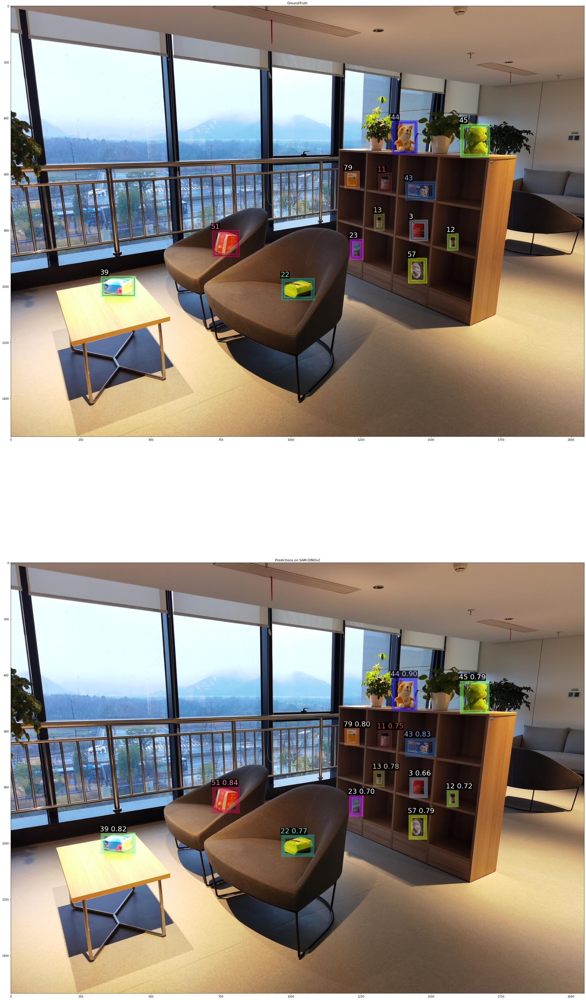

In [ ]:
# demo_eval_gdino_FFA.py

#!/usr/bin/env python
# coding: utf-8


# Testing:
# 1. Object Proposal Generation by Grounded SAM
# 2. Feature Extraction for proposals by DINOv2
# 3. Proposal/Instance Matching -- Stable Matching

# In[6]:

import time
import argparse
import cv2
import glob
import json
import logging
import os
import sys
import random
import numpy as np
import matplotlib.pyplot as plt
from typing import List, Optional

import torch
from torch import nn
import torch.backends.cudnn as cudnn
from torchvision import transforms as pth_transforms
import torchvision.transforms as T

sys.path.append("../detectron2")
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances


# sys.path.append("../dinov2-main")
# from dinov2.eval.setup import get_args_parser as get_setup_args_parser


sys.path.append(".")
from utils.visualizer import ColorMode, Visualizer
from utils.instance_det_dataset import RealWorldDataset
from utils.inference_utils import compute_similarity, stableMatching, get_bbox_masks_from_gdino_sam, \
    get_object_proposal, getColor, create_instances, nms, apply_nms, get_features
from tqdm import trange
from adapter import ModifiedClipAdapter, WeightAdapter
from utils.img_utils import get_masked_image

# logger = logging.getLogger("dinov2")


def get_args_parser(
        description: Optional[str] = None,
        parents: Optional[List[argparse.ArgumentParser]] = [],
        add_help: bool = True,
):
    #setup_args_parser = get_setup_args_parser(parents=parents, add_help=False)
    parents = []

    parser = argparse.ArgumentParser(
        description=description,
        parents=parents,
        add_help=add_help,
    )
    parser.add_argument(
        "--train_path",
        default="../database/train",
        type=str,
        help="Path to train dataset.",
    )
    parser.add_argument(
        "--test_path",
        default="../database/test",
        type=str,
        help="Path to test dataset.",
    )
    parser.add_argument(
        "--imsize",
        default=448,
        type=int,
        help="Image size",
    )
    parser.add_argument(
        "--output_dir",
        default="./output",
        type=str,
        help="Path to save outputs.")
    parser.add_argument("--num_workers", default=0, type=int, help="Number of data loading workers per GPU.")

    parser.add_argument(
        "--gather-on-cpu",
        action="store_true",
        help="Whether to gather the train features on cpu, slower"
             "but useful to avoid OOM for large datasets (e.g. ImageNet22k).",
    )

    parser.set_defaults(
        train_dataset="Object",
        test_dataset="Scene",
        batch_size=1,
        num_workers=0,
    )
    return parser


# In[8]:


# Default args and initialize model
args_parser = get_args_parser(description="Grounded SAM-DINOv2 Instance Detection")
imsize = 448
tag = "mask"  # bbox
img_id = 2
args = args_parser.parse_args(args=["--train_path", "database/Objects",
                                    "--test_path", "test_data/test_1/test_"+str(img_id).zfill(3)+".jpg",  # test_002
                                    "--output_dir", "exps/demo0501_" + str(imsize) + "_" + tag,
                                    ])
os.makedirs(args.output_dir, exist_ok=True)


# use dino v2 to extract features
encoder = torch.hub.load('facebookresearch/dinov2', 'dinov2_vitl14_reg')
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
encoder.to(device)
encoder.eval()

# Assuming the model's architecture is defined in 'FeatureVectorModel' class
use_adapter = False
adapter_type = "weight"
if use_adapter:
    input_features = 1024
    if adapter_type == "clip":
        adapter_args = 'Ins_ratio_0.6_temp_0.05_epoch_40_lr_0.001_bs_1024_vec_reduction_4_L2e4_vitl_reg'
        model_path = 'adapter_weights/adapter2FC/'+adapter_args+'_weights.pth'
        adapter = ModifiedClipAdapter(input_features, reduction=4, ratio=0.6).to('cuda')
    elif adapter_type == "weight":
        adapter_args = 'Ins_weighted_10sigmoid_ratio_0.6_temp_0.05_epoch_40_lr_0.001_bs_1024_vec_reduction_4_L2e4_vitl_reg'
        model_path = 'adapter_weights/adapter2FC/' + adapter_args + '_weights.pth'
        adapter = WeightAdapter(input_features, reduction=4).to('cuda')

    # Load the weights
    adapter.load_state_dict(torch.load(model_path))

    # If you plan to only evaluate the model, switch to eval mode
    adapter.eval()

    print('Model weights loaded and model is set to evaluation mode.')



# In[9]:

output_dir = './obj_FFA'
json_filename = 'object_features_vitl14_reg.json'
# json_filename = "object_features_l_reg_class.json"
if use_adapter:
    output_dir = './adapted_obj_feats'
    json_filename = adapter_args+'.json'


with open(os.path.join(output_dir, json_filename), 'r') as f:
    feat_dict = json.load(f)


object_features = torch.Tensor(feat_dict['features']).to(device)
object_features = nn.functional.normalize(object_features, dim=1, p=2)
print("object_features: ", object_features.shape) # Shape (2400, 1024)

# In[10]:
from absl import app, logging
from PIL import Image as PILImg


from robokit.ObjDetection import GroundingDINOObjectPredictor, SegmentAnythingPredictor

# Path to the input image
image_path = args.test_path


logging.info("Initialize object detectors")
gdino = GroundingDINOObjectPredictor(use_vitb=False, threshold=0.15)
SAM = SegmentAnythingPredictor(vit_model="vit_h")

logging.info("Open the image and convert to RGB format")
image_pil = PILImg.open(image_path).convert("RGB")

# #### 1. Get object proposals with Grounded-SAM
accurate_bboxs, masks = get_bbox_masks_from_gdino_sam(image_path, gdino, SAM, text_prompt='objects', visualize=False)


# #### 2. Crop proposals from the high-resolution version

# In[11]:

start_time = time.time()
scene_features_list = []
proposals_list = []
scene_name_list = []
mask = masks.cpu().numpy()
accurate_bboxs = accurate_bboxs.cpu().numpy()
scene_name = os.path.basename(image_path).split('.')[0]
scene_name_list.append(scene_name)
rois, sel_rois, cropped_imgs, cropped_masks = get_object_proposal(args.test_path, accurate_bboxs, masks, tag=tag, ratio=0.25, save_rois=False, output_dir=args.output_dir, save_proposal=False)
scene_features = []
for i in trange(len(cropped_imgs)):
    img = cropped_imgs[i]
    mask = cropped_masks[i]
    ffa_feature= get_features([img], [mask], encoder,device=device, img_size=imsize) # Dino mese features nikal ke avg
    with torch.no_grad():
        if use_adapter:
            ffa_feature = adapter(ffa_feature)
    scene_features.append(ffa_feature)
scene_features = torch.cat(scene_features, dim=0)
scene_features = nn.functional.normalize(scene_features, dim=1, p=2)

scene_features_list.append(scene_features)
# total_proposals[scene_name] = sel_rois
proposals_list.append(sel_rois)
# rgb_normalize = T.Compose(
#             [
#                 T.ToTensor(),
#                 T.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
#             ]
#         )
# masks = masks.squeeze(1).to(torch.float32)
# rois, sel_rois, cropped_imgs, cropped_masks = get_object_proposal_tensor(args.test_path, accurate_bboxs, masks, img_size=448, rgb_normalize=rgb_normalize,tag=tag, ratio=0.25, save_rois=True, output_dir=args.output_dir)
# scene_features = []
#

# batch_size = 32  # Define the batch size
#
# dataset = TensorDataset(cropped_imgs, cropped_masks)
# # Create a DataLoader
# data_loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)
#
# # Iterate over the DataLoader
# for image_batch, mask_batch in data_loader:
#     ffa_feature = get_features_via_batch_tensor(image_batch, mask_batch, encoder, img_size=imsize)
#     if use_adapter:
#         ffa_feature = adapter(ffa_feature)
#     # Extend the main feature list with the features from this batch
#     scene_features.append(ffa_feature)
# scene_features = torch.cat(scene_features, dim=0)
# scene_features = nn.functional.normalize(scene_features, dim=1, p=2)
# Capture the end time
end_time = time.time()

# Calculate and print the total time
print(f"Total running time: {end_time - start_time} seconds")

# image_height, image_width = raw_image.shape[:-1]
scene_name = os.path.basename(args.test_path).split('.')[0]



# In[13]:


# transform = pth_transforms.Compose([pth_transforms.ToTensor(),])
#
# # for demo
# scene_dataset = RealWorldDataset(args.output_dir, scene_name, data=rois, transform=transform, imsize=args.imsize)
# scene_features = get_scene_feature(args.output_dir, scene_name, scene_dataset, model, args.batch_size, args.num_workers)


# ####  3. Compute Cosine Similarity and Proposal/Instance Matching

# In[7]:

# reshape scene feature matrix
# scene_cnt = [0, *scene_dataset.cfg['length']]
# scene_idx = [sum(scene_cnt[:i + 1]) for i in range(len(scene_cnt))]
# scene_features_list = [scene_features[scene_idx[i]:scene_idx[i + 1]] for i in
#                         range(len(scene_dataset.cfg['length']))]
#
# proposals = scene_dataset.cfg['proposals']
# proposals_list = [proposals[scene_idx[i]:scene_idx[i + 1]] for i in range(len(scene_dataset.cfg['length']))]

num_object = 100 # len(object_dataset.cfg['obj_name'])
num_example = len(object_features) // num_object

results = []

for idx, scene_feature in enumerate(scene_features_list):
    sim_mat = compute_similarity(object_features, scene_feature)
    sim_mat = sim_mat.view(len(scene_feature), num_object, num_example)
    sims, _ = torch.max(sim_mat, dim=2)  # choose max score over profile examples of each object instance
    max_ins_sim, initial_result = torch.max(sims, dim=1)

    proposals = proposals_list[idx]
    num_proposals = len(proposals)

    ########################################## Stable Matching Strategy ##########################################
    do_matching = True
    if do_matching:
        # ------------ ranking and sorting ------------
        # Initialization
        sel_obj_ids = [str(v) for v in list(np.arange(num_object))]  # ids for selected obj
        sel_roi_ids = [str(v) for v in list(np.arange(len(scene_feature)))]  # ids for selected roi

        # Padding
        max_len = max(len(sel_roi_ids), len(sel_obj_ids))
        sel_sims_symmetric = torch.ones((max_len, max_len)) * -1
        sel_sims_symmetric[:len(sel_roi_ids), :len(sel_obj_ids)] = sims.clone()

        pad_len = abs(len(sel_roi_ids) - len(sel_obj_ids))
        if len(sel_roi_ids) > len(sel_obj_ids):
            pad_obj_ids = [str(i) for i in range(num_object, num_object + pad_len)]
            sel_obj_ids += pad_obj_ids
        elif len(sel_roi_ids) < len(sel_obj_ids):
            pad_roi_ids = [str(i) for i in range(len(sel_roi_ids), len(sel_roi_ids) + pad_len)]
            sel_roi_ids += pad_roi_ids

        # ------------ stable matching ------------
        matchedMat = stableMatching(
            sel_sims_symmetric.detach().data.cpu().numpy())  # predMat is raw predMat
        predMat_row = np.zeros_like(
            sel_sims_symmetric.detach().data.cpu().numpy())  # predMat_row is the result after stable matching
        Matches = dict()
        for i in range(matchedMat.shape[0]):
            tmp = matchedMat[i, :]
            a = tmp.argmax()
            predMat_row[i, a] = tmp[a]
            Matches[sel_roi_ids[i]] = sel_obj_ids[int(a)]
        print("Done!")

        # ------------ thresholding ------------
        preds = Matches.copy()
        # for key, value in Matches.items():
        #     if sel_sims_symmetric[int(sel_roi_ids.index(key)), int(sel_obj_ids.index(value))] <= score_thresh_predefined:
        #         del preds[key]
        #         continue

        # ------------ save per scene results ------------

        for k, v in preds.items():
            if int(k) >= num_proposals:  # since the number of proposals is less than the number of object features
                break

            result = dict()
            result['image_id'] = proposals[int(k)]['image_id']
            result['category_id'] = int(v)
            result['bbox'] = proposals[int(k)]['bbox']
            result['score'] = float(sims[int(k), int(v)])
            result['image_width'] = proposals[int(k)]['image_width']
            result['image_height'] = proposals[int(k)]['image_height']
            result['scale'] = proposals[int(k)]['scale']
            results.append(result)
    else:
        THRESHOLD_OBJECT_SCORE = 0.6
        for i in range(num_proposals):
            if float(max_ins_sim[i]) < THRESHOLD_OBJECT_SCORE:
                continue
            result = dict()
            result['image_id'] = proposals[i]['image_id']
            result['category_id'] = initial_result[i].item()
            result['bbox'] = proposals[i]['bbox']
            result['score'] = float(max_ins_sim[i])
            result['image_width'] = proposals[i]['image_width']
            result['image_height'] = proposals[i]['image_height']
            result['scale'] = proposals[i]['scale']
            results.append(result)


    # print("Done!")


# ### Save Results

# In[8]:


# save final results
with open(os.path.join(args.output_dir, "coco_instances_results.json"), "w") as f:
    json.dump(results, f)

predictions = dict(
    [(k, {'image_id': -1, 'instances': []}) for k in range(len(scene_name_list))])
for idx in range(len(results)):
    id = results[idx]['image_id']
    predictions[scene_name_list.index('test_' + str(id).zfill(3))]['image_id'] = id

    predictions[scene_name_list.index('test_' + str(id).zfill(3))]['instances'].append(results[idx])

torch.save(predictions, os.path.join(args.output_dir, "instances_predictions.pth"))

print('Done!')


# ### Visualization

# In[9]:

# Random custom colors with a fixed random seed
random.seed(77)
thing_colors = []
for i in range(100):
    thing_colors.append(getColor())


# In[10]:


# Register Test Data for COCO evaluation
test_path = "./test_data/test_4" # 1 for raw data, 2 for ratio=0.5, 4 for ratio=0.25, 8 for ratio=0.125  # test_4
# test_json = "./test_data/annotations/instances_test_4.json"  # instances_test_4
test_json = "./test_data/annotations/single_image_ground_truth_"+str(img_id)+".json"  # instances_test_4
register_coco_instances("coco_InsDet_test", {}, test_json, test_path)
MetadataCatalog.get("coco_InsDet_test").thing_colors = thing_colors


# In[11]:


pred_dir = os.path.join(args.output_dir,"predictions")
os.makedirs(pred_dir, exist_ok=True)
test_metadata = MetadataCatalog.get("coco_InsDet_test")
test_dataset_dicts = DatasetCatalog.get("coco_InsDet_test")

idx = scene_name_list.index(scene_name)
# d = test_dataset_dicts[int(scene_name.split('_')[-1])]
d = test_dataset_dicts[0] # idx
img = cv2.imread(d["file_name"])
base_name = os.path.basename(d["file_name"]).split(".")[0]

# visualize GT
visGT = Visualizer(img[:, :, ::-1],
                   metadata=test_metadata,
                   scale=1.0,
                   instance_mode=ColorMode.SEGMENTATION)
vis_gt = visGT.draw_dataset_dict(d)
cv2.imwrite(os.path.join(pred_dir, base_name + "_gt.jpg"),
            vis_gt.get_image()[:, :, ::-1])

# visualize pred
# predictions = torch.load(os.path.join(args.output_dir, "instances_predictions.pth"))
pred = create_instances(predictions[idx]['instances'], img.shape[:2], test_metadata)
keep_ids = apply_nms(pred)  # apply NMS

visPred = Visualizer(img[:, :, ::-1],
                     metadata=test_metadata,
                     scale=1.0,
                     instance_mode=ColorMode.SEGMENTATION)
vis_pred = visPred.draw_instance_predictions(pred.to("cpu"), keep_ids)
cv2.imwrite(os.path.join(pred_dir, base_name + "_pred_SAM+DINOv2.jpg"),
            vis_pred.get_image()[:, :, ::-1])


# =================================================================================================================
# Evaluation Result for single image

from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval

# Load the ground truth COCO dataset
cocoGt = COCO('test_data/annotations/single_image_ground_truth_'+str(img_id)+'.json')

# Load your detection results
cocoDt = cocoGt.loadRes(os.path.join(args.output_dir, "coco_instances_results.json"))

# Create a COCOeval object by initializing it with the ground truth and detection results
cocoEval = COCOeval(cocoGt, cocoDt, 'bbox')

# Run the evaluation
cocoEval.evaluate()
cocoEval.accumulate()
cocoEval.summarize()

# 'bbox' specifies that we are doing evaluation for bounding box detection.
# You can change it to 'segm' for segmentation tasks.


# In[12]:


fig = plt.figure(figsize=(30,60), dpi=64, facecolor='w', edgecolor='k')
ax = plt.subplot(211)
ax.set_title("GroundTruth")
plt.imshow(vis_gt.get_image()[:, :, :])
ax = plt.subplot(212)
ax.set_title("Predictions on SAM-DINOv2")
plt.imshow(vis_pred.get_image()[:, :, :])
plt.tight_layout()
# plt.savefig('./result_images/InsDet/'+base_name+'_SAM_DINOv2.png', dpi=300)
plt.show()

Evaluation result

In [ ]:
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval
import os
# Load the ground truth COCO dataset
img_id = 2
cocoGt = COCO('test_data/annotations/single_image_ground_truth_'+str(img_id)+'.json')

# Load your detection results
cocoDt = cocoGt.loadRes(os.path.join("/content/NIDS-Net/exps/demo0501_448_mask", "coco_instances_results.json"))

# Create a COCOeval object by initializing it with the ground truth and detection results
cocoEval = COCOeval(cocoGt, cocoDt, 'bbox')

# Run the evaluation
cocoEval.evaluate()
cocoEval.accumulate()
cocoEval.summarize()

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.01s).
Accumulating evaluation results...
DONE (t=0.05s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.931
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.931
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDet

In [ ]:
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval
import os
# Load the ground truth COCO dataset
img_id = 2
cocoGt = COCO('test_data/annotations/single_image_ground_truth_'+str(img_id)+'.json')

# Load your detection results
cocoDt = cocoGt.loadRes(os.path.join("/content/NIDS-Net/exps/demo0501_448_mask", "coco_instances_results.json"))

# Create a COCOeval object by initializing it with the ground truth and detection results
cocoEval = COCOeval(cocoGt, cocoDt, 'bbox')

# Run the evaluation
cocoEval.evaluate()
cocoEval.accumulate()
cocoEval.summarize()

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.01s).
Accumulating evaluation results...
DONE (t=0.07s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.931
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.931
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDet

# Single Image test on NIDSxFEATUP (FOR TESTING/ EXPERIEMENTING)


final text_encoder_type: bert-base-uncased
Model loaded from C:\Users\divya\.cache\huggingface\hub\models--ShilongLiu--GroundingDINO\snapshots\a94c9b567a2a374598f05c584e96798a170c56fb\groundingdino_swint_ogc.pth 
 => _IncompatibleKeys(missing_keys=[], unexpected_keys=['label_enc.weight', 'bert.embeddings.position_ids'])


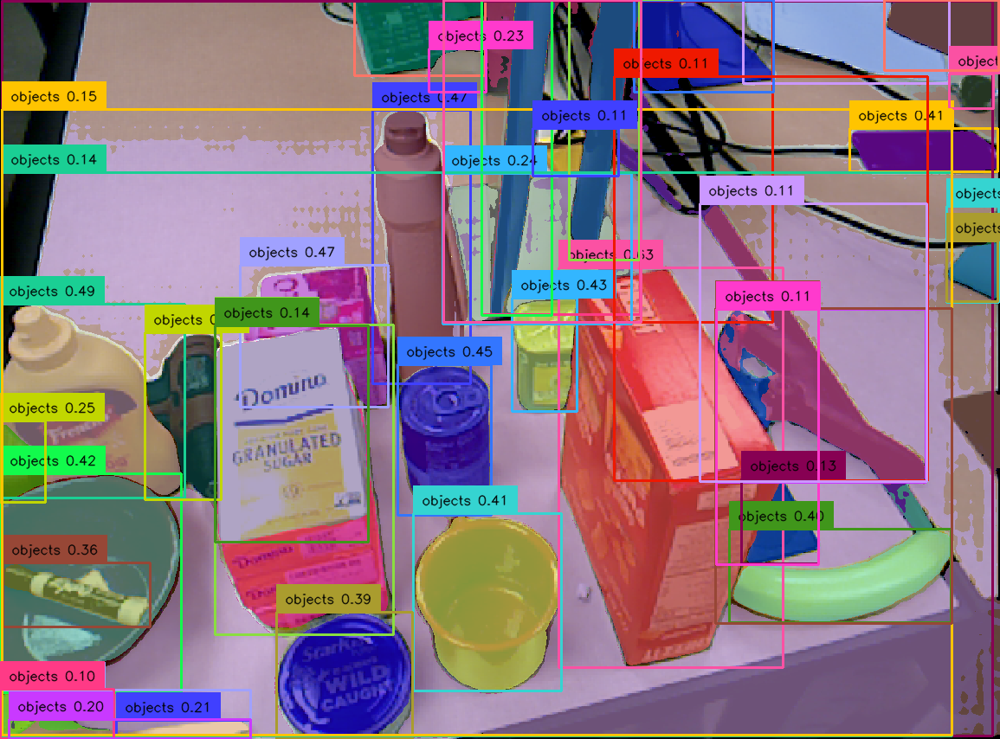

In [1]:
from absl import app, logging
from PIL import Image as PILImg
from robokit.utils import annotate, overlay_masks
from robokit.ObjDetection import GroundingDINOObjectPredictor, SegmentAnythingPredictor
from IPython.display import display

def test_gsam(image_path):
    # Path to the input image
    text_prompt = 'objects'

    try:
        logging.info("Initialize object detectors")
        gdino = GroundingDINOObjectPredictor()
        SAM = SegmentAnythingPredictor()

        logging.info("Open the image and convert to RGB format")
        image_pil = PILImg.open(image_path).convert("RGB")

        logging.info("GDINO: Predict bounding boxes, phrases, and confidence scores")
        bboxes, phrases, gdino_conf = gdino.predict(image_pil, text_prompt)

        logging.info("GDINO post processing")
        w, h = image_pil.size # Get image width and height
        # Scale bounding boxes to match the original image size
        image_pil_bboxes = gdino.bbox_to_scaled_xyxy(bboxes, w, h)

        logging.info("SAM prediction")
        image_pil_bboxes, masks = SAM.predict(image_pil, image_pil_bboxes)

        logging.info("Annotate the scaled image with bounding boxes, confidence scores, and labels, and display")
        bbox_annotated_pil = annotate(overlay_masks(image_pil, masks), image_pil_bboxes, gdino_conf, phrases)

        display(bbox_annotated_pil)

    except Exception as e:
        # Handle unexpected errors
        print(f"An unexpected error occurred: {e}")

test_gsam('imgs/clutter-test.png')

In [1]:
# demo_eval_gdino_FFA.py
import time
import argparse
import cv2
import glob
import json
import logging
import os
import sys
import random
import numpy as np
import matplotlib.pyplot as plt
from typing import List, Optional

import torch
from torch import nn
import torch.backends.cudnn as cudnn
from torchvision import transforms as pth_transforms
import torchvision.transforms as T

sys.path.append("../detectron2")
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances

sys.path.append(".")
from utils.visualizer import ColorMode, Visualizer
from utils.instance_det_dataset import RealWorldDataset
from utils.inference_utils import compute_similarity, stableMatching, get_bbox_masks_from_gdino_sam, \
    get_object_proposal, getColor, create_instances, nms, apply_nms, get_features
from tqdm import trange
from adapter import ModifiedClipAdapter, WeightAdapter
from utils.img_utils import get_masked_image

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# output_dir = 'D:/CODE/NIDS-Net/feats'
# json_filename = 'high_resolution_object_features_vitl14_reg.json'

# encoder = torch.hub.load('facebookresearch/dinov2', 'dinov2_vitl14_reg')
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# encoder.to(device)
# encoder.eval()

# with open(os.path.join(output_dir, json_filename), 'r') as f:
#     feat_dict = json.load(f)

# object_features = torch.Tensor(feat_dict['features']).to(device)
# object_features = nn.functional.normalize(object_features, dim=1, p=2)
# print("object_features: ", object_features.shape) # Shape (2400, 1024)

# Featup
output_dir_featup = 'D:/CODE/NIDS-Net/feats'
json_filename_featup = 'object_features.json'

upsampler = torch.hub.load("mhamilton723/FeatUp", 'dinov2')
upsampler.to('cuda')
upsampler.eval()

with open(os.path.join(output_dir_featup, json_filename_featup), 'r') as f:
    feat_dict_featup = json.load(f)

object_features_featup = torch.Tensor(feat_dict_featup['features']).to(device)
object_features_featup = nn.functional.normalize(object_features_featup, dim=1, p=2)
print("object_features Featup: ", object_features_featup.shape) # Shape (2400, 384)

Using cache found in C:\Users\divya/.cache\torch\hub\mhamilton723_FeatUp_main
C:\Users\divya/.cache\torch\hub\mhamilton723_FeatUp_main\featup\featurizers\dinov2\layers\swiglu_ffn.py:51: UserWarning: xFormers is not available (SwiGLU)
  warnings.warn("xFormers is not available (SwiGLU)")
C:\Users\divya/.cache\torch\hub\mhamilton723_FeatUp_main\featup\featurizers\dinov2\layers\attention.py:33: UserWarning: xFormers is not available (Attention)
  warnings.warn("xFormers is not available (Attention)")
C:\Users\divya/.cache\torch\hub\mhamilton723_FeatUp_main\featup\featurizers\dinov2\layers\block.py:40: UserWarning: xFormers is not available (Block)
  warnings.warn("xFormers is not available (Block)")
Using cache found in C:\Users\divya/.cache\torch\hub\facebookresearch_dinov2_main
C:\Users\divya/.cache\torch\hub\facebookresearch_dinov2_main\dinov2\layers\swiglu_ffn.py:51: UserWarning: xFormers is not available (SwiGLU)
  warnings.warn("xFormers is not available (SwiGLU)")
C:\Users\divya/.c

object_features Featup:  torch.Size([2400, 384])


In [8]:
torch.cuda.empty_cache()

In [2]:
# In[10]:
from absl import app, logging
from PIL import Image as PILImg
from robokit.ObjDetection import GroundingDINOObjectPredictor, SegmentAnythingPredictor

# Path to the input image
imsize = 448
tag = "mask"  # bbox
img_id = 39
image_path = "test_data/test_1/test_"+str(img_id).zfill(3)+".jpg" # << Since single image eval so load that image
test_path = "test_data/test_1/test_"+str(img_id).zfill(3)+".jpg"
output_dir = "exps/demo0501_" + str(imsize) + "_" + tag

logging.info("Initialize object detectors")
gdino = GroundingDINOObjectPredictor(use_vitb=False, threshold=0.15)
SAM = SegmentAnythingPredictor(vit_model="vit_h")

logging.info("Open the image and convert to RGB format")
image_pil = PILImg.open(image_path).convert("RGB")

# #### 1. Get object proposals with Grounded-SAM
logging.info("1. Get object proposals with Grounded-SAM")
with torch.no_grad():
    accurate_bboxs, masks = get_bbox_masks_from_gdino_sam(image_path, gdino, SAM, text_prompt='objects', visualize=False)
print(accurate_bboxs.shape)

final text_encoder_type: bert-base-uncased
Model loaded from C:\Users\divya\.cache\huggingface\hub\models--ShilongLiu--GroundingDINO\snapshots\a94c9b567a2a374598f05c584e96798a170c56fb\groundingdino_swint_ogc.pth 
 => _IncompatibleKeys(missing_keys=[], unexpected_keys=['label_enc.weight', 'bert.embeddings.position_ids'])
torch.Size([35, 4])


In [3]:
torch.cuda.empty_cache()

In [4]:
from utils.inference_utils import FFA_preprocess, get_foreground_mask
# #### 2. Crop proposals from the high-resolution version
logging.info("2. Crop proposals from the high-resolution version")
# In[11]:

start_time = time.time()
scene_features_list = []
proposals_list = []
scene_name_list = []
mask = masks.cpu().numpy()
accurate_bboxs = accurate_bboxs.cpu().numpy()
scene_name = os.path.basename(image_path).split('.')[0]
scene_name_list.append(scene_name)
rois, sel_rois, cropped_imgs, cropped_masks = get_object_proposal(test_path, accurate_bboxs, masks, tag=tag, ratio=0.25, save_rois=False, output_dir=output_dir, save_proposal=False)
scene_features = []

In [5]:
def get_features_2(images, masks, encoder, variant="Crop-Feat", device="cuda", img_size=336):
    """Get Foreground feature average from the model

    Args:
        images: input images. a list of PIL.Image
        masks: input masks. a list of PIL.Image
        model: model to extract features

    Returns:
        features: extracted features. shape of [N, C]
    """
    with torch.no_grad():
        preprocessed_imgs = FFA_preprocess(images, img_size).to(device)
        mask_size = img_size // 14
        masks = get_foreground_mask(masks, mask_size).to(device)
        if variant == "Crop-Feat":
            emb = encoder.forward_features(preprocessed_imgs)
        elif variant == "Crop-Img":
            emb = encoder.forward_features(FFA_preprocess(images, img_size).to(device))
        else:
            raise ValueError("Invalid variant, only Crop-Feat and Crop-Img are supported.")

        grid = emb["x_norm_patchtokens"].view(len(images), mask_size, mask_size, -1)
        avg_feature = (grid * masks.permute(0, 2, 3, 1)).sum(dim=(1, 2)) / masks.sum(dim=(1, 2, 3)).unsqueeze(-1)

        return avg_feature, grid

  0%|          | 0/35 [00:00<?, ?it/s]

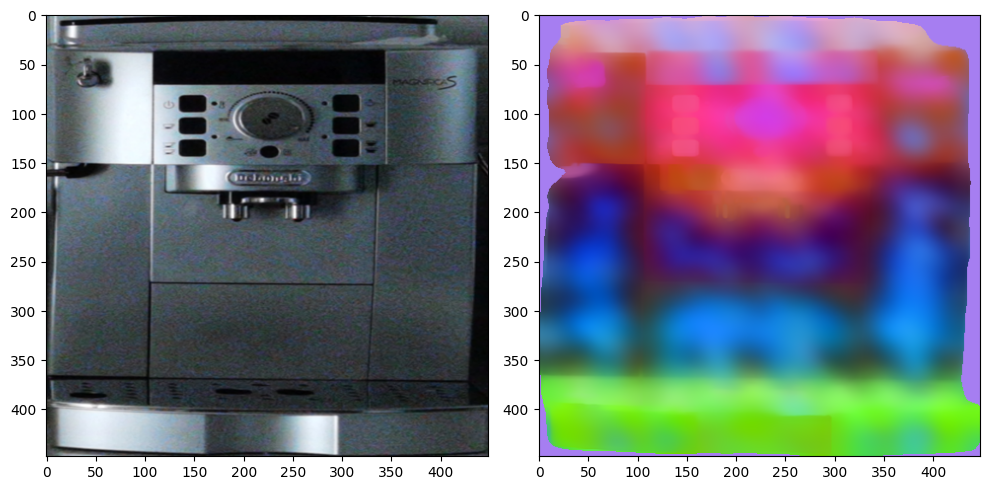

  3%|▎         | 1/35 [00:13<07:40, 13.55s/it]

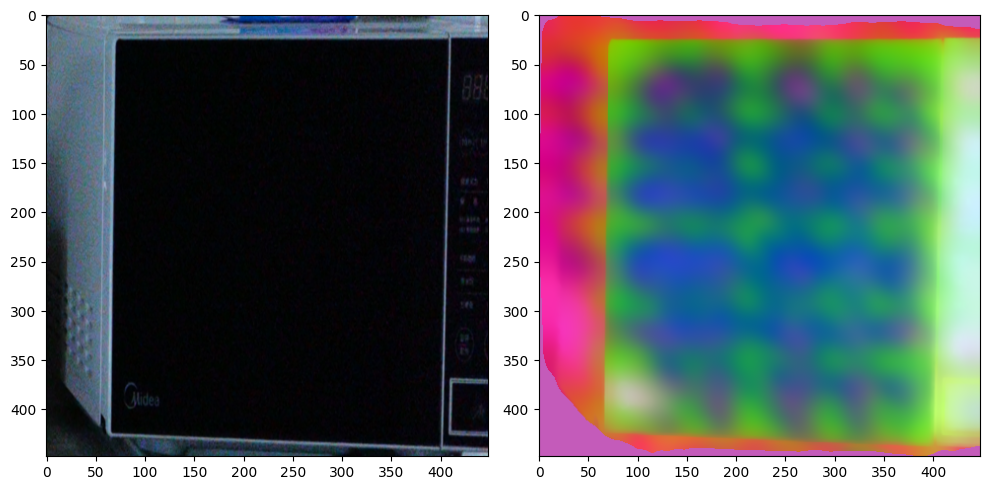

  6%|▌         | 2/35 [00:24<06:27, 11.73s/it]

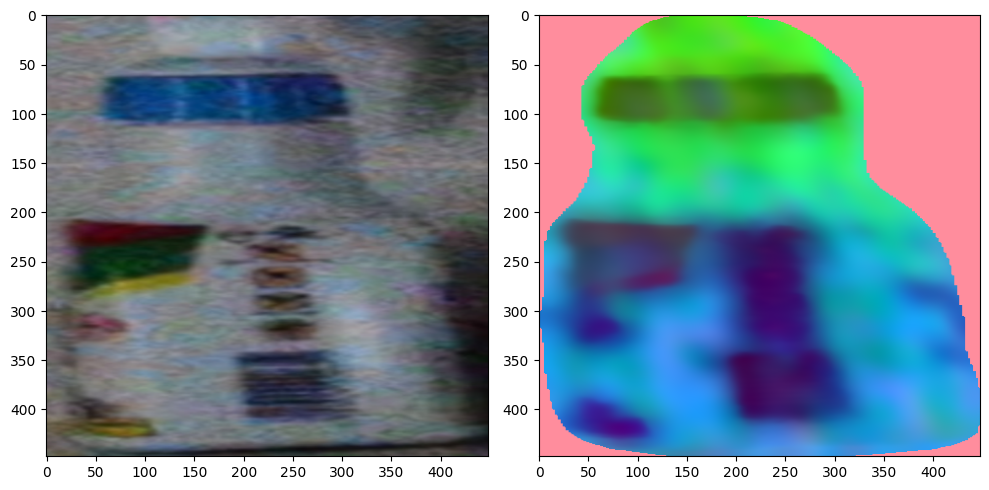

  9%|▊         | 3/35 [00:37<06:38, 12.46s/it]

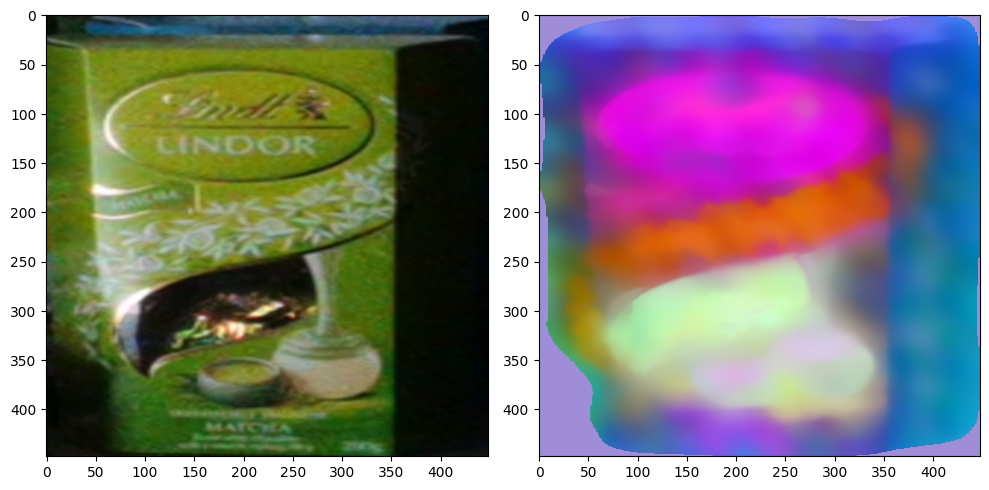

 11%|█▏        | 4/35 [00:46<05:45, 11.16s/it]

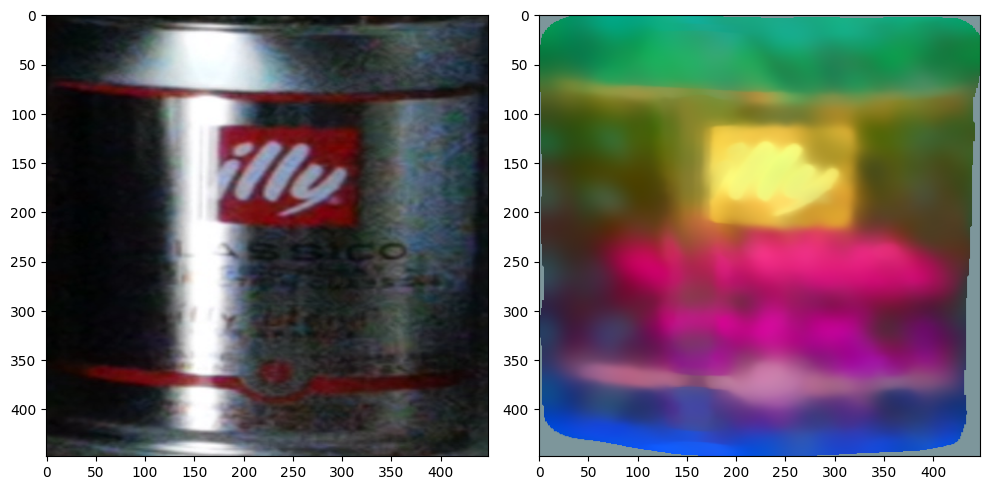

 14%|█▍        | 5/35 [01:00<06:01, 12.05s/it]

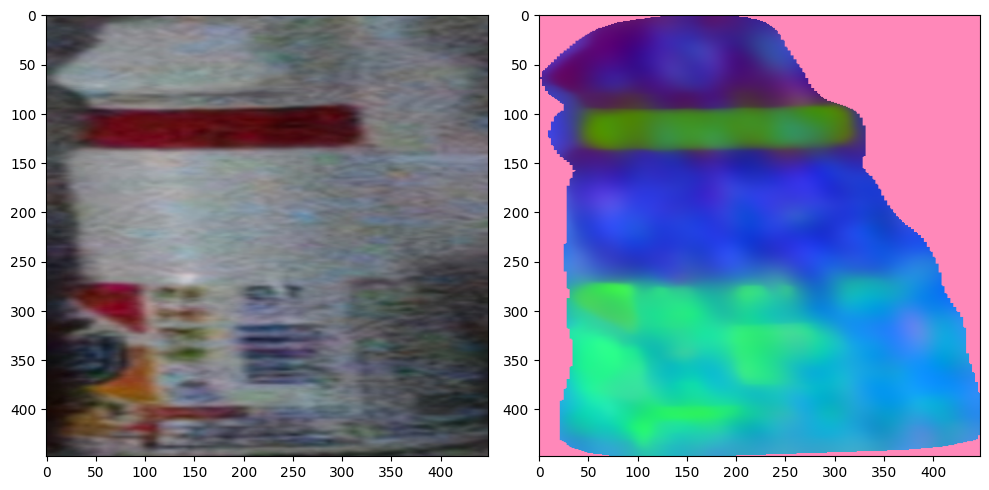

 17%|█▋        | 6/35 [01:07<05:01, 10.40s/it]

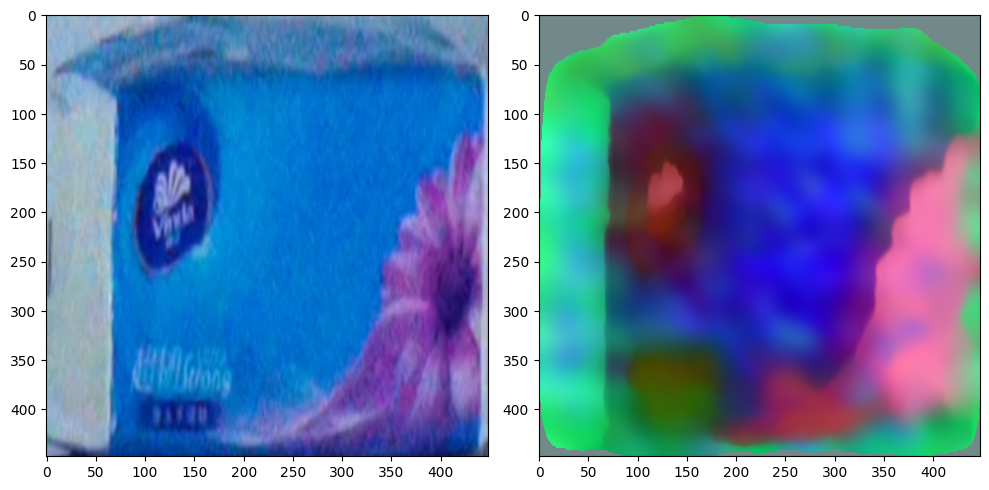

 20%|██        | 7/35 [01:23<05:42, 12.22s/it]

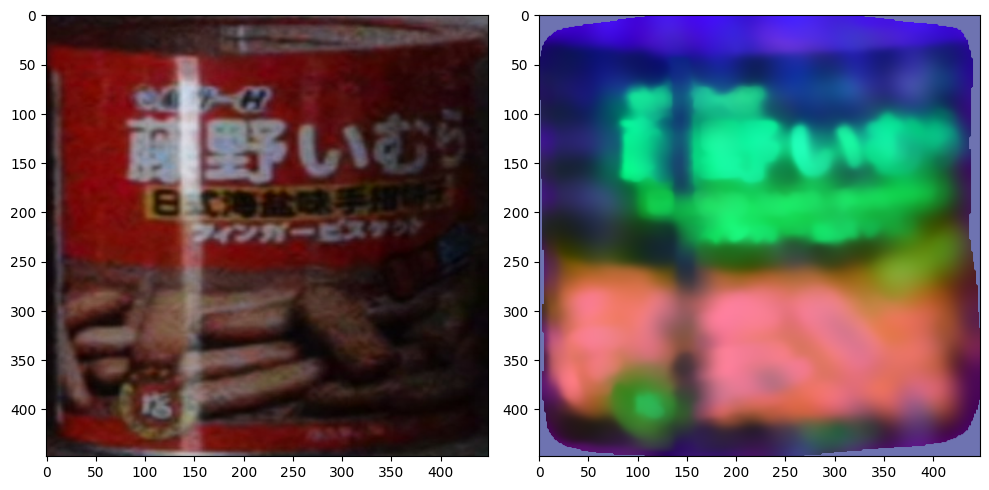

 23%|██▎       | 8/35 [01:28<04:32, 10.11s/it]

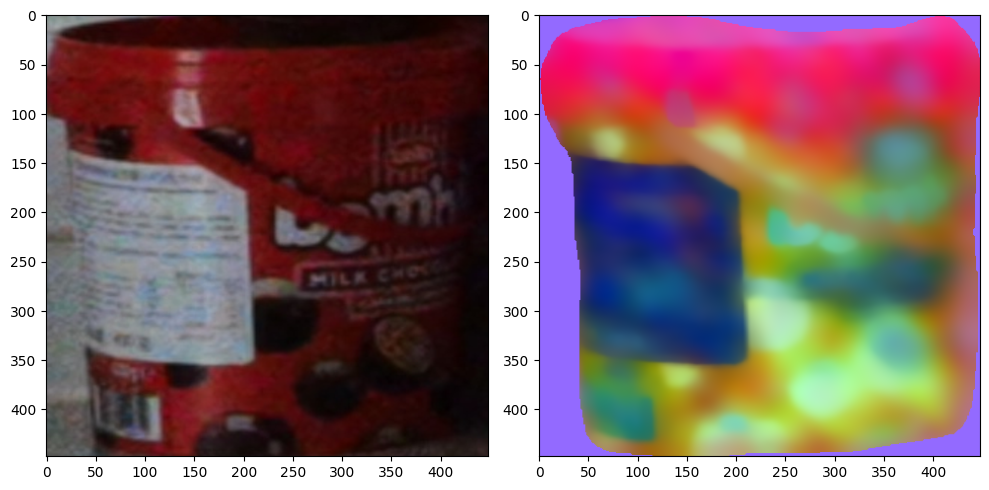

 26%|██▌       | 9/35 [01:36<04:04,  9.40s/it]

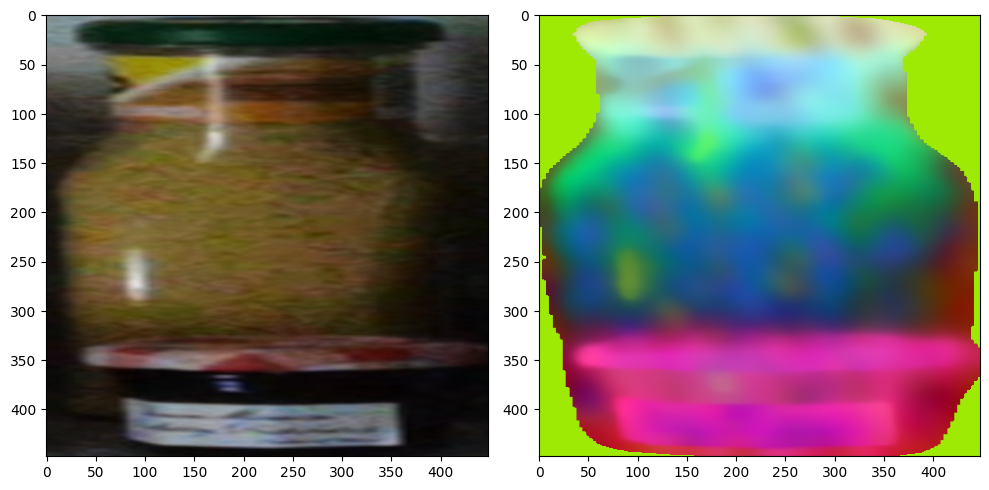

 29%|██▊       | 10/35 [01:44<03:39,  8.77s/it]

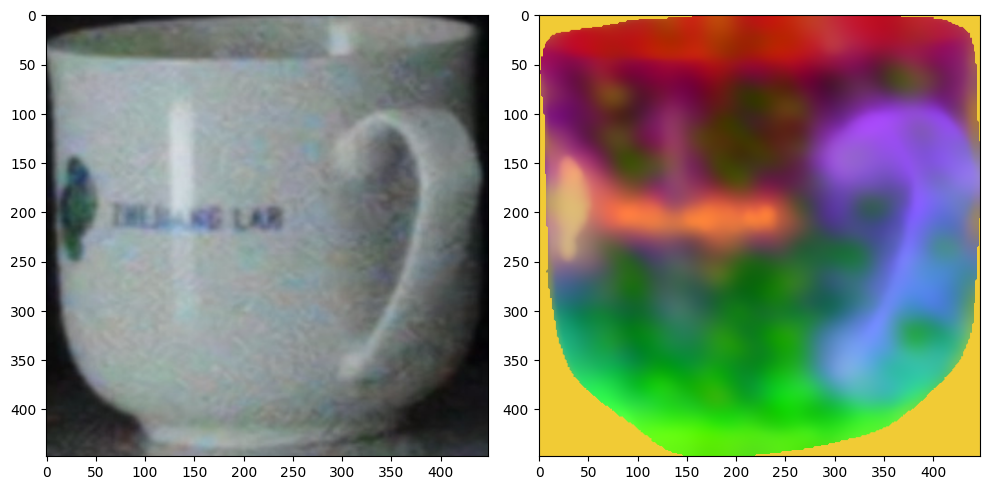

 31%|███▏      | 11/35 [01:51<03:23,  8.47s/it]

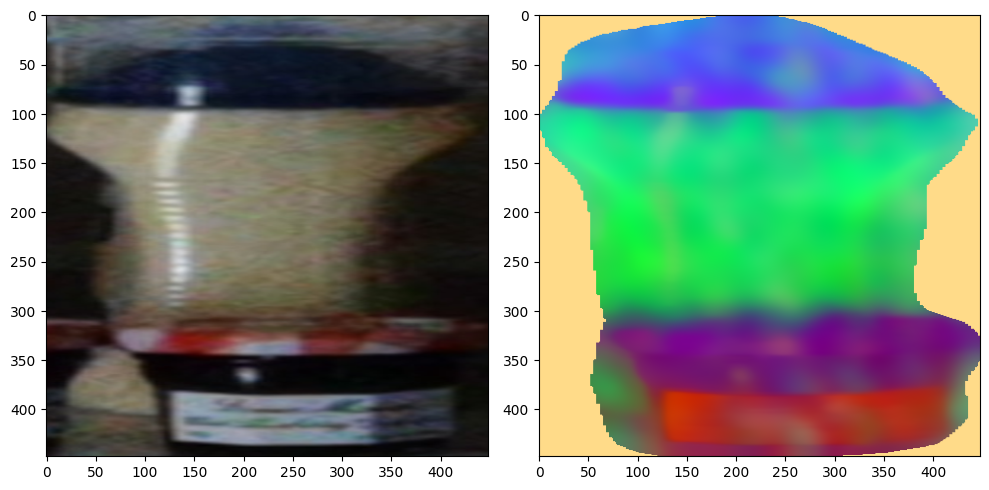

 34%|███▍      | 12/35 [01:57<02:57,  7.72s/it]

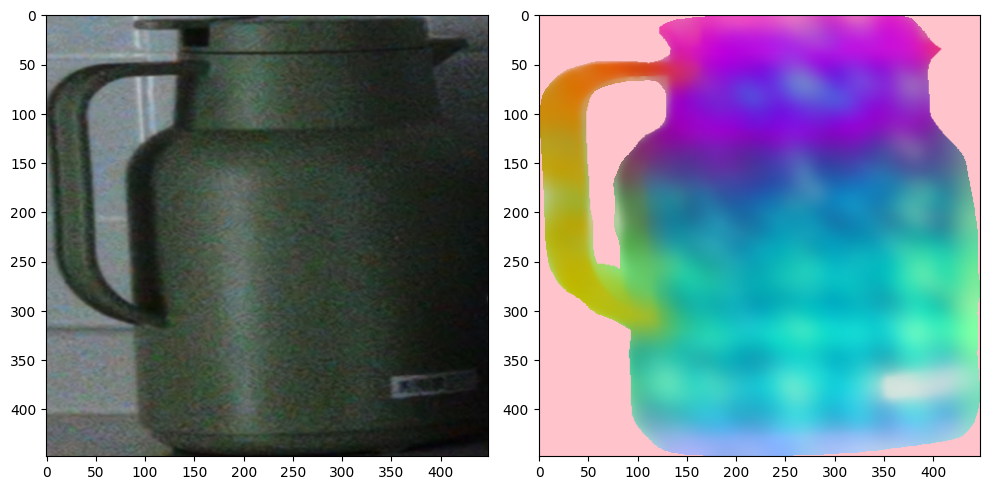

 37%|███▋      | 13/35 [02:06<02:58,  8.14s/it]

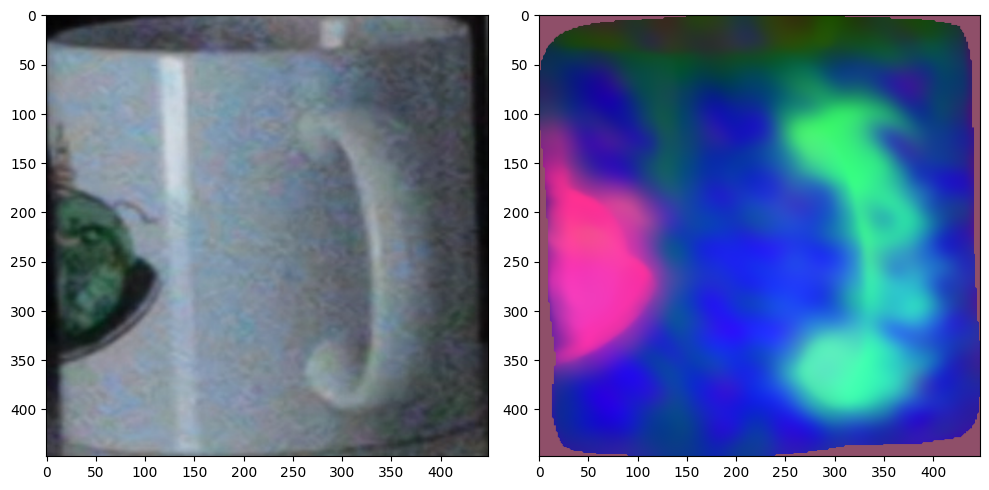

 40%|████      | 14/35 [02:17<03:06,  8.88s/it]

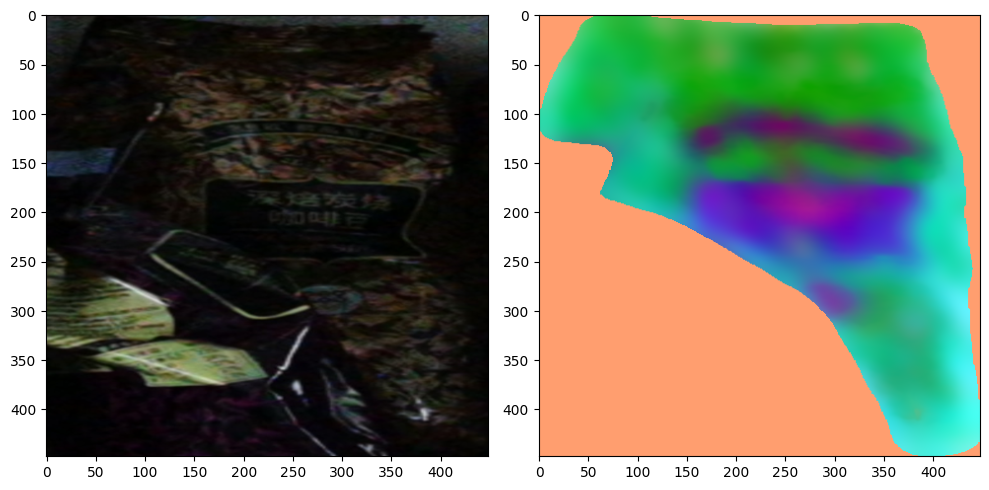

 43%|████▎     | 15/35 [02:25<02:49,  8.45s/it]

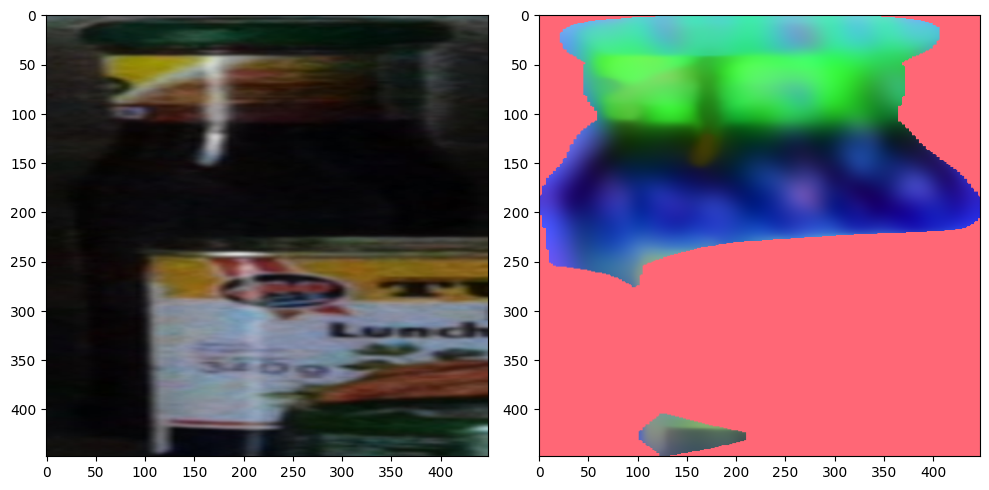

 46%|████▌     | 16/35 [02:32<02:33,  8.07s/it]

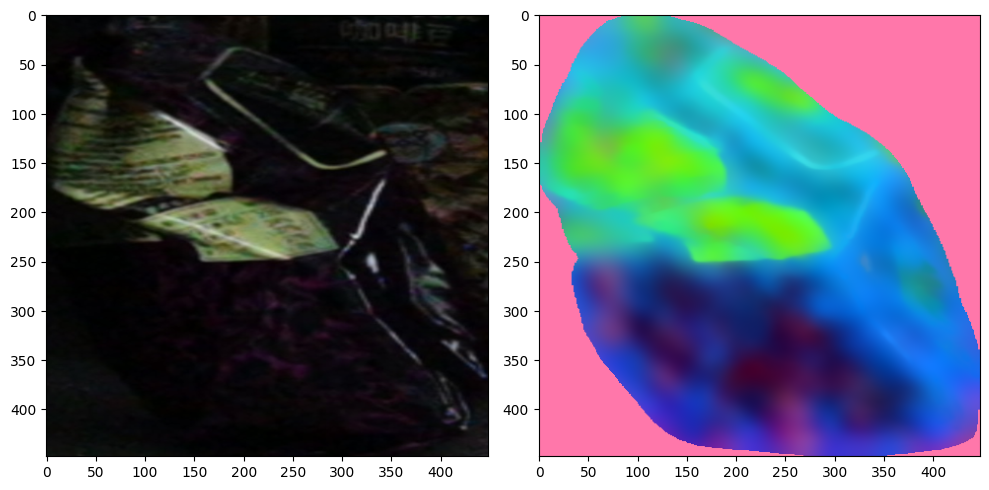

 49%|████▊     | 17/35 [02:39<02:23,  7.96s/it]

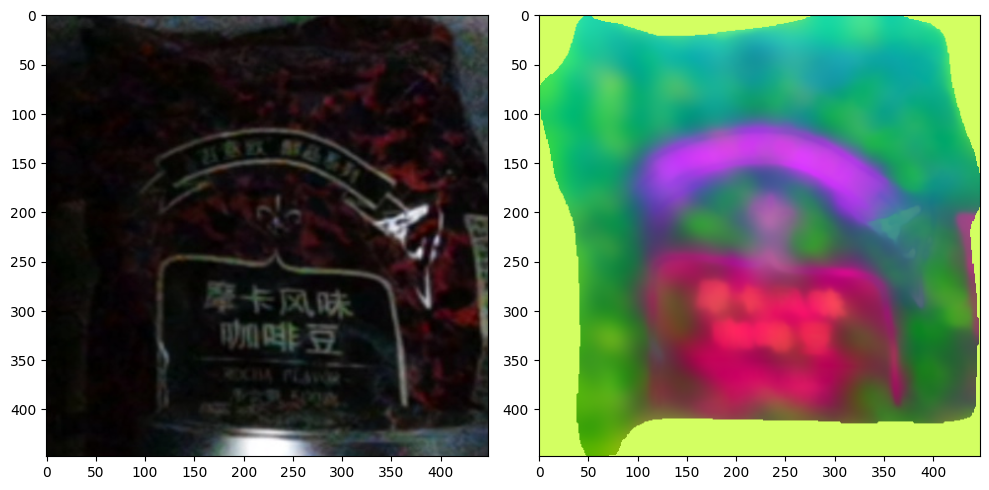

 51%|█████▏    | 18/35 [02:46<02:07,  7.47s/it]

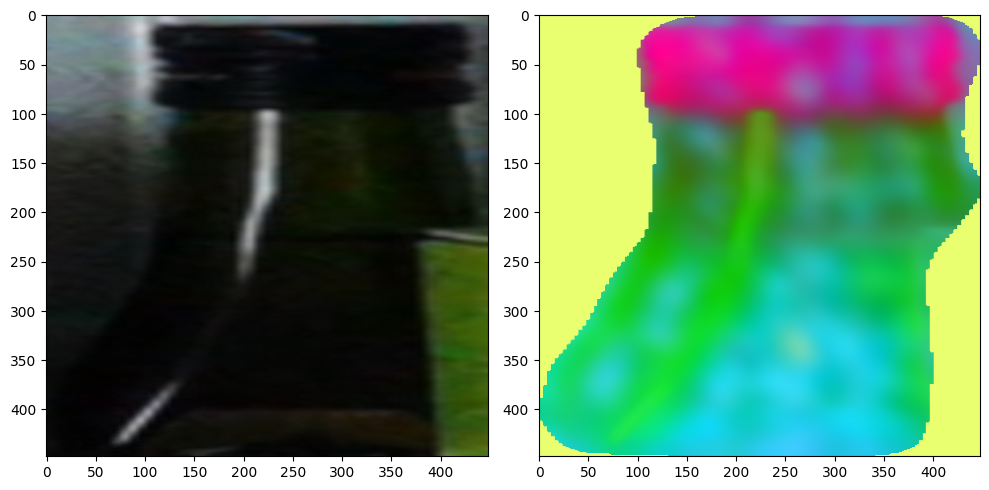

 54%|█████▍    | 19/35 [02:55<02:06,  7.91s/it]

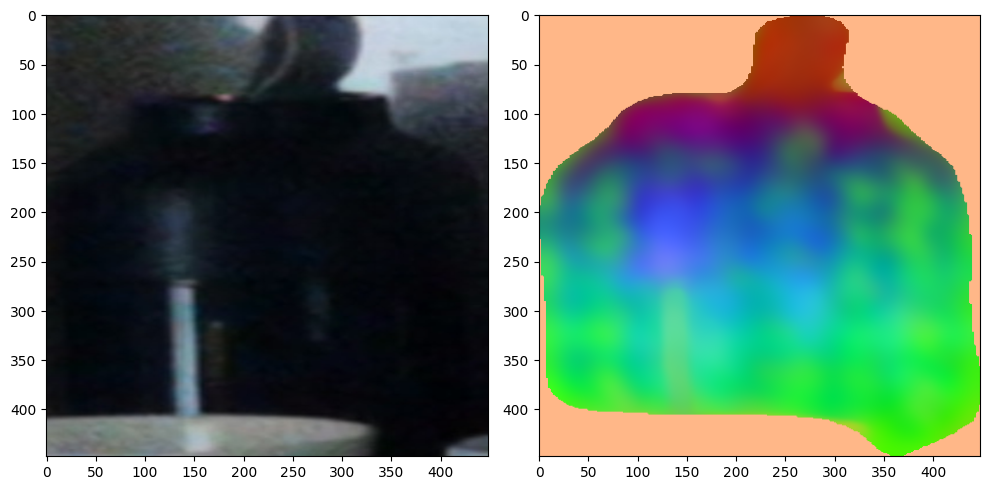

 57%|█████▋    | 20/35 [03:05<02:11,  8.77s/it]

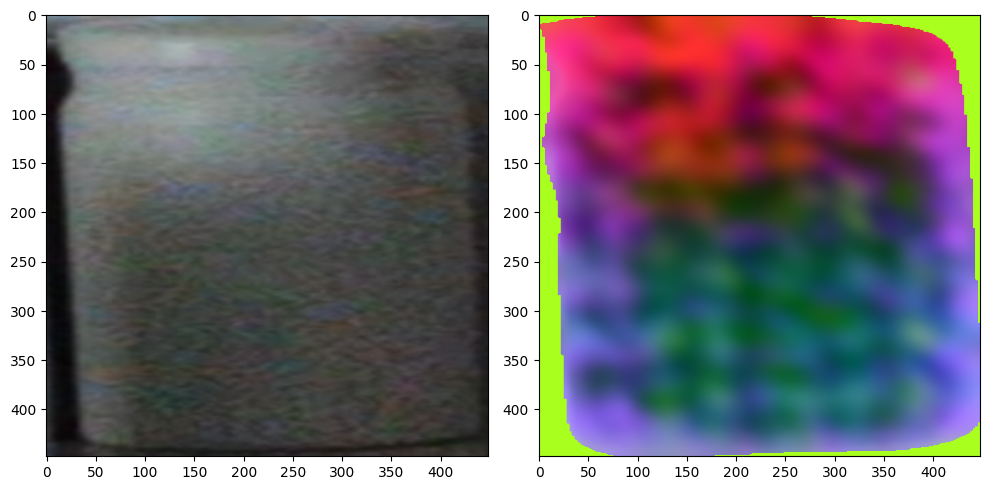

 60%|██████    | 21/35 [03:13<01:56,  8.32s/it]

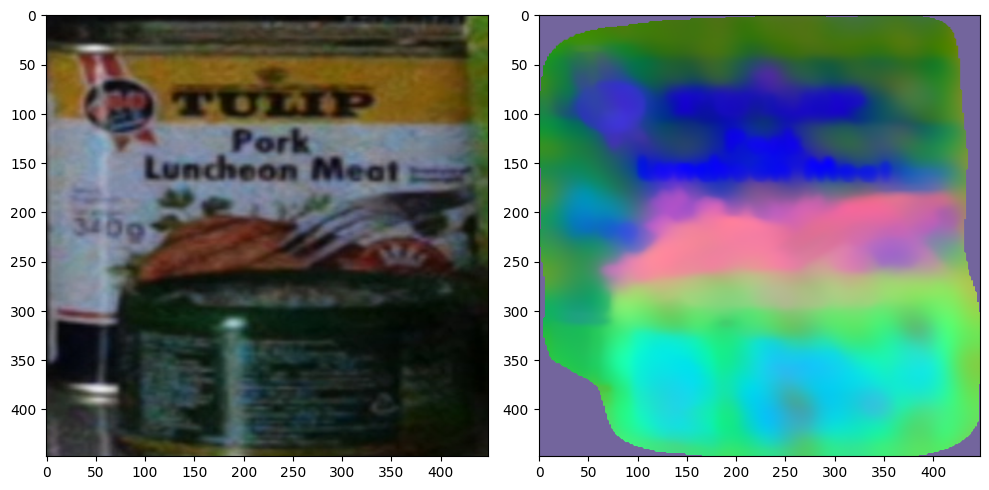

 63%|██████▎   | 22/35 [03:20<01:44,  8.01s/it]

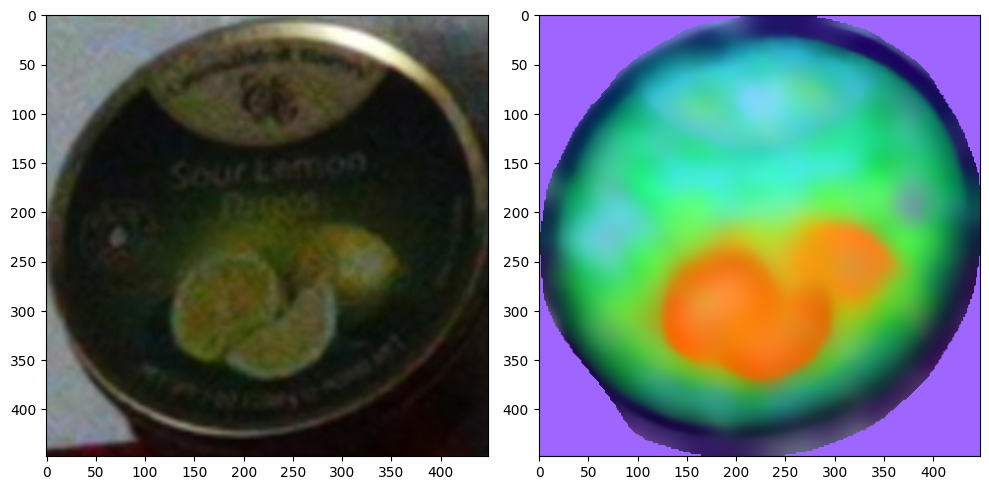

 66%|██████▌   | 23/35 [03:28<01:35,  7.93s/it]

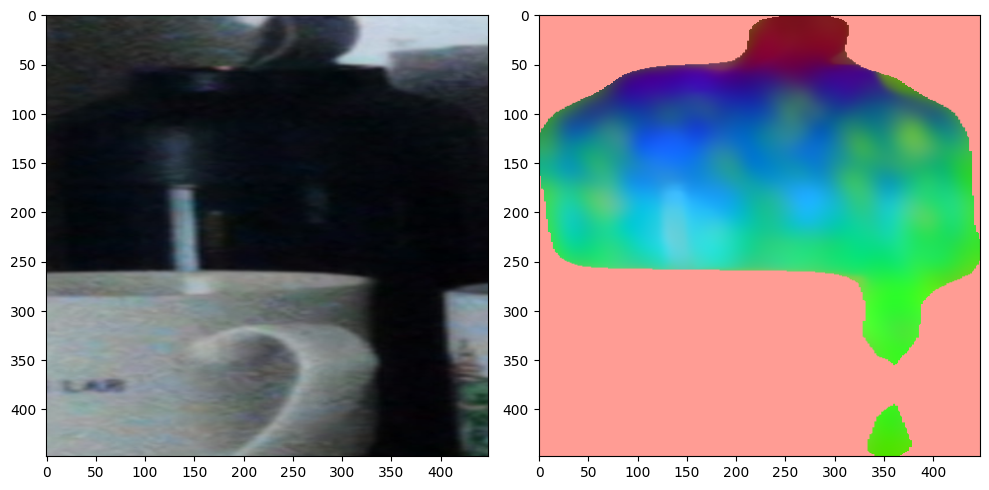

 69%|██████▊   | 24/35 [03:34<01:20,  7.30s/it]

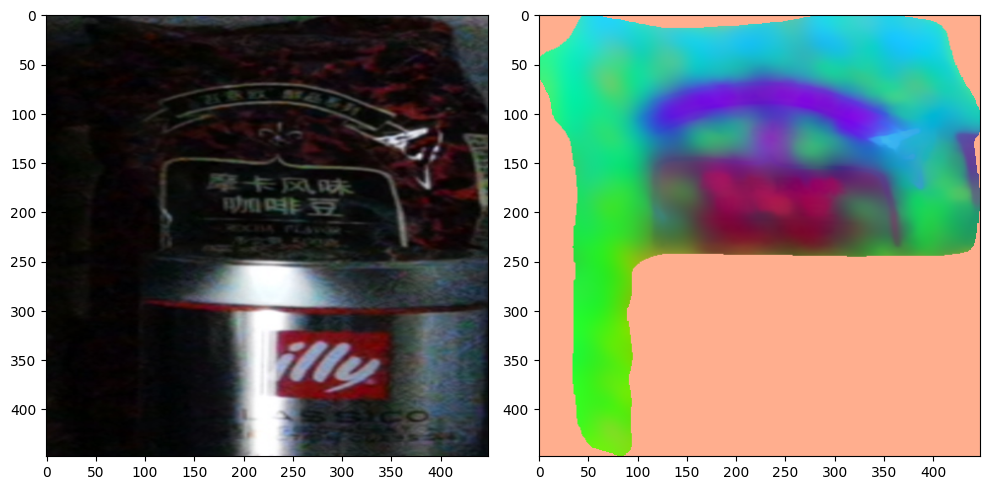

 71%|███████▏  | 25/35 [03:42<01:17,  7.77s/it]

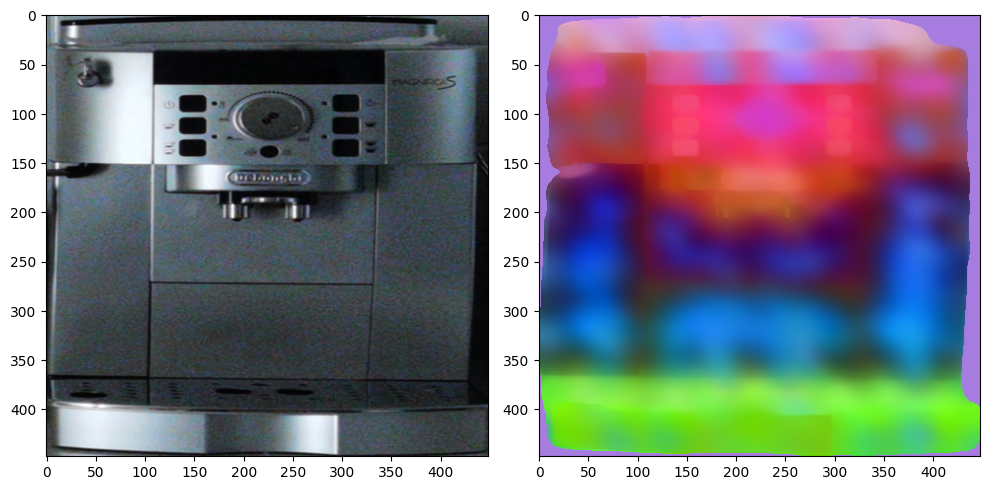

 74%|███████▍  | 26/35 [03:53<01:17,  8.65s/it]

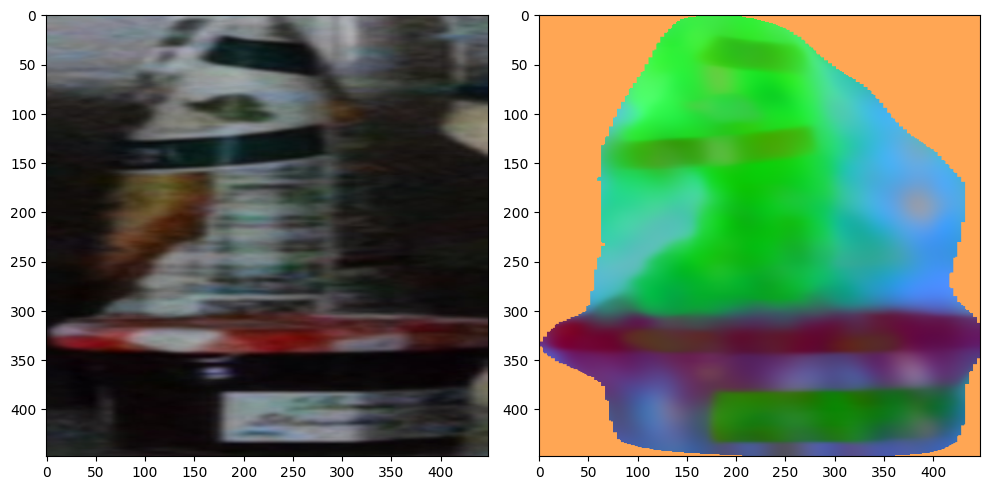

 77%|███████▋  | 27/35 [04:00<01:05,  8.24s/it]

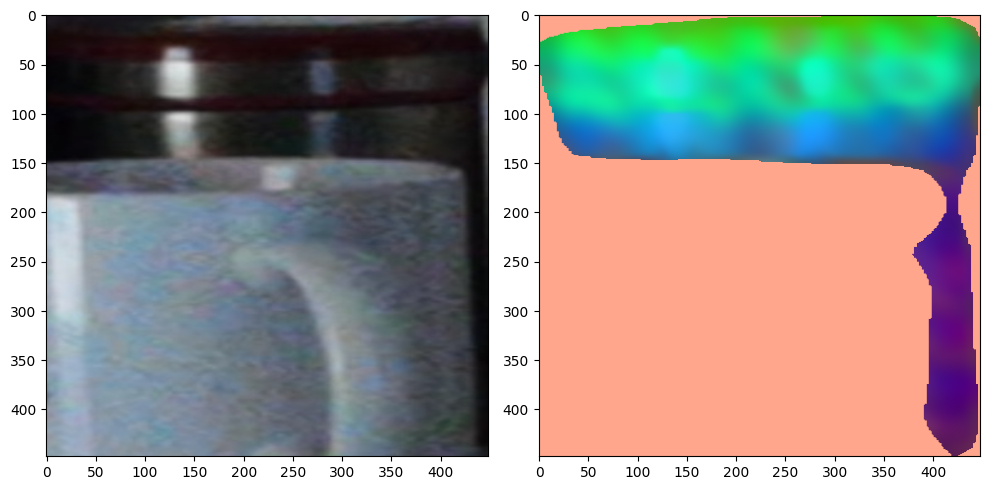

 80%|████████  | 28/35 [04:08<00:55,  7.96s/it]

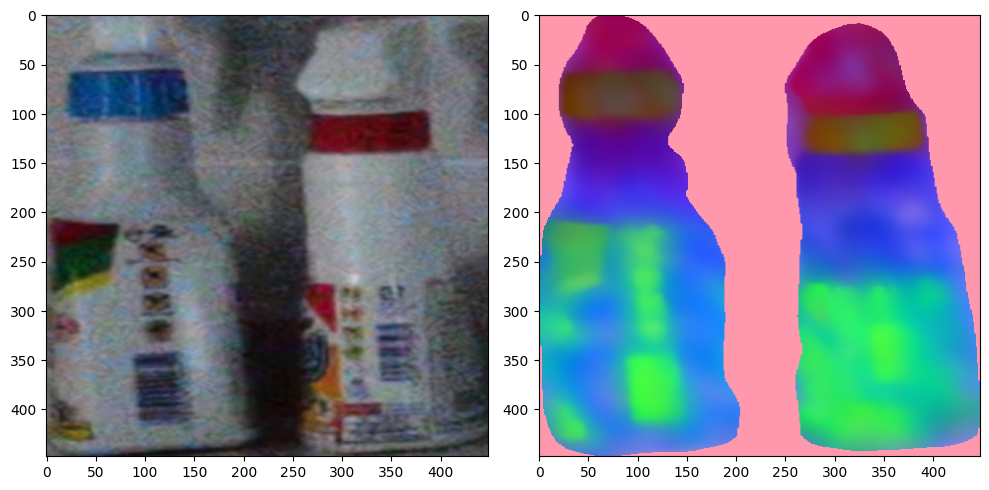

 83%|████████▎ | 29/35 [04:15<00:47,  7.89s/it]

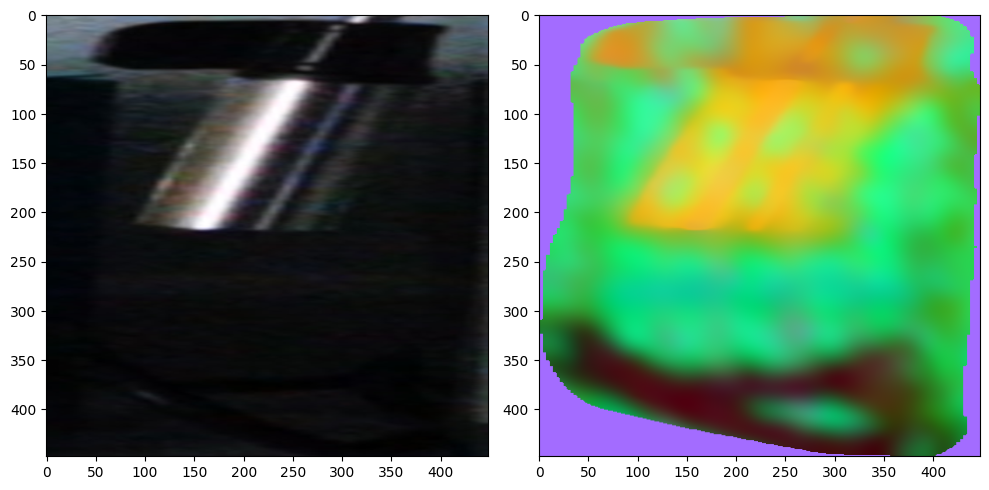

 86%|████████▌ | 30/35 [04:21<00:36,  7.30s/it]

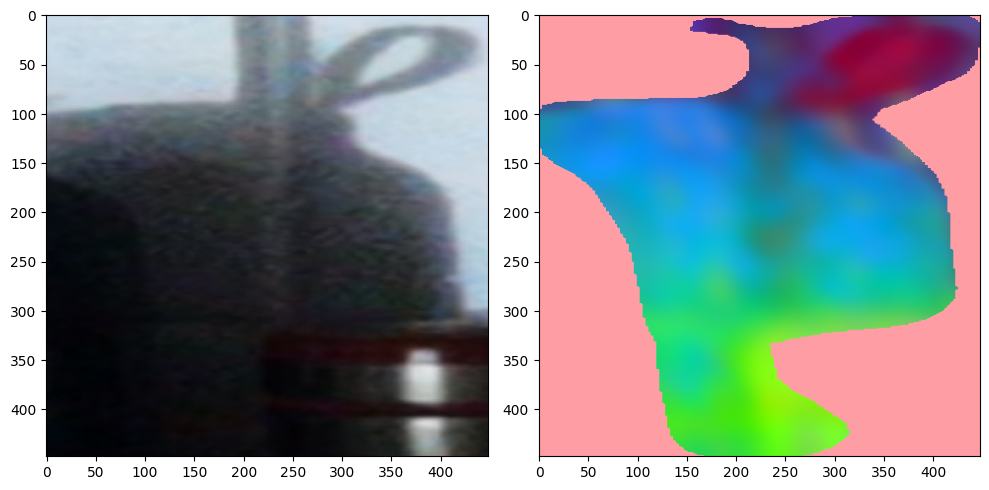

 89%|████████▊ | 31/35 [04:30<00:30,  7.73s/it]

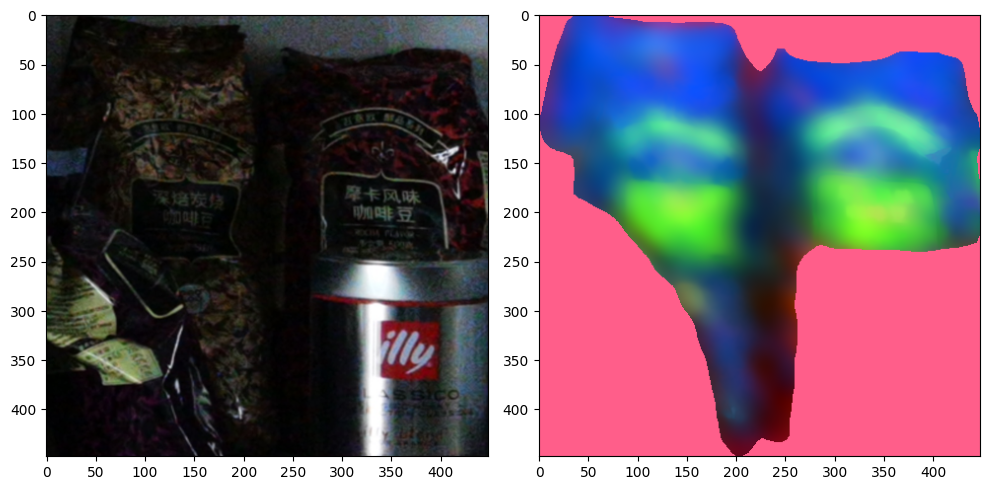

 91%|█████████▏| 32/35 [04:41<00:25,  8.53s/it]

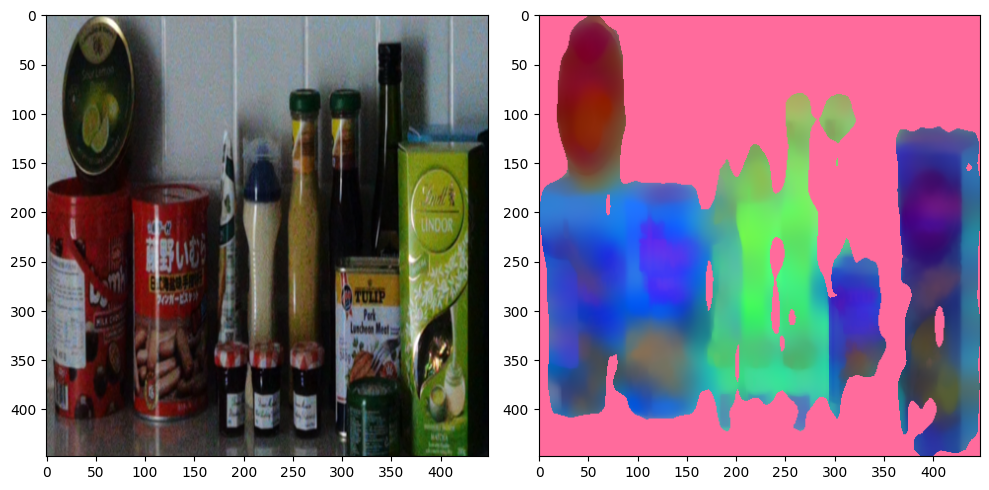

 94%|█████████▍| 33/35 [04:48<00:16,  8.19s/it]

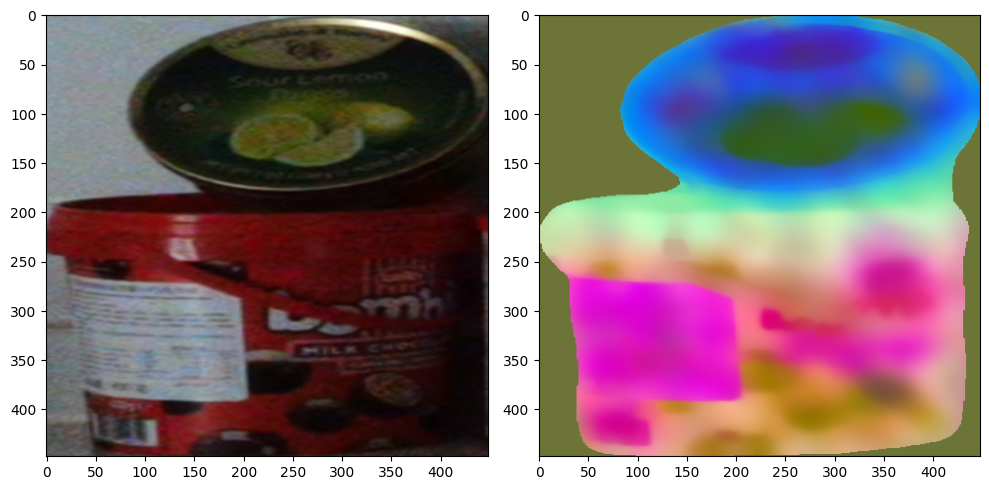

 97%|█████████▋| 34/35 [04:56<00:08,  8.03s/it]

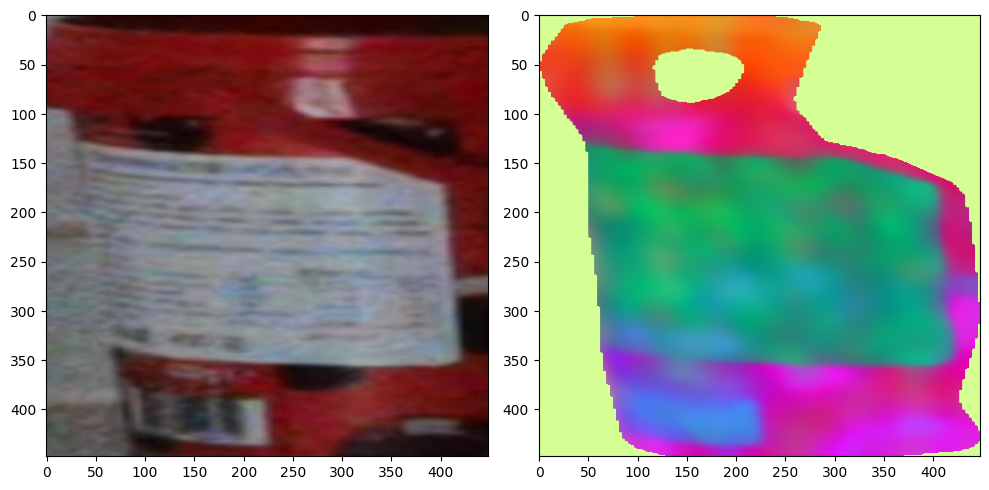

100%|██████████| 35/35 [05:03<00:00,  8.68s/it]


In [6]:
from featup.util import pca, unnorm
from utils.inference_utils import compute_similarity, stableMatching, get_bbox_masks_from_gdino_sam, \
    get_object_proposal, getColor, create_instances, nms, apply_nms

with torch.no_grad():
  for i in trange(len(cropped_imgs)):

    # BOTH ARE RAW
    img = cropped_imgs[i]
    mask = cropped_masks[i]

    # result = get_features_2([img], [mask], encoder=encoder,device=device, img_size=imsize) # Dino mese features nikal ke avg
    # ffa_feature, grid = result
    # preprocessed_imgs = FFA_preprocess([img], img_size=imsize).to(device)
    # grid = grid.permute(0, 3, 1, 2)
    # [grid], _ = pca([grid], dim=9)
    # og_img = unnorm(preprocessed_imgs)[0].permute(1, 2, 0).detach().cpu()
    # print(f"\n{grid.shape=} & {og_img.shape=}")
    # fig, ax = plt.subplots(1, 2, figsize=(10, 20))
    # ax[0].imshow(og_img)
    # ax[1].imshow(grid[0, :3].permute(1,2,0).detach().cpu())
    # plt.tight_layout()
    # plt.show()
    # scene_features.append(ffa_feature)
      

    preprocessed_imgs = FFA_preprocess([img], img_size=imsize).to(device)
    masks = get_foreground_mask([mask], mask_size=imsize).to(device)  # Shape: (1, 1, H, W)

    hr_feats = upsampler(preprocessed_imgs)                   # Shape: (1, 384, 512, 512)
    hr_feats = torch.nn.functional.interpolate(hr_feats, masks.shape[2:], mode="bilinear") # Shape: (1, 384, H, W)
    # print(f"{hr_feats.shape=}")
    hr_feats = hr_feats.permute(0,2,3,1) # Shape: (1, H, W, 384)

    # Padding dummy tensors
    # h, w = masks.shape[2:]
    # padding_tensor = nn.Parameter(torch.randn(1, h, w, 384))  # Shape: (1, H, W, 384)
    # hr_feats = torch.cat(hr_feats,padding_tensor)                      # Shape: (1, H, W, 384)

    # TODO: Add MRL (Matryoshka Representation Learning) to hr_feats and reduce the dimensions and then avg it out
    ffa_feature = (hr_feats * masks.permute(0, 2, 3, 1)).sum(dim=(1, 2)) / masks.sum(dim=(1, 2, 3)).unsqueeze(-1) # Shape: (1, 384) 
    # print(f"{ffa_feature.shape=}")

    # Ploting hr_feats & rois
    feats = hr_feats * masks.permute(0, 2, 3, 1)
    feats = feats.permute(0, 3, 1, 2)
    [feats], _ = pca([feats], dim=9)
    og_img = unnorm(preprocessed_imgs)[0].permute(1, 2, 0).detach().cpu()
    # print(f"\n{feats.shape=} & {og_img.shape=}")
    fig, ax = plt.subplots(1, 2, figsize=(10, 20))
    ax[0].imshow(og_img)
    ax[1].imshow(feats[0, :3].permute(1,2,0).detach().cpu())
    plt.tight_layout()
    plt.show()
    scene_features.append(ffa_feature)

In [7]:
scene_features = torch.cat(scene_features, dim=0)
scene_features = nn.functional.normalize(scene_features, dim=1, p=2)

scene_features_list.append(scene_features)
proposals_list.append(sel_rois)

# Capture the end time
end_time = time.time()

# Calculate and print the total time
print(f"Total running time: {end_time - start_time} seconds")

# image_height, image_width = raw_image.shape[:-1]
scene_name = os.path.basename(test_path).split('.')[0]

Total running time: 584.3814516067505 seconds


In [8]:
def calculate_area(bbox):
    x1, y1, x2, y2 = bbox
    return (x2 - x1) * (y2 - y1)

In [10]:
num_object = 100 # len(object_dataset.cfg['obj_name'])
num_example = len(object_features_featup) // num_object

results = []

for idx, scene_feature in enumerate(scene_features_list):
    sim_mat = compute_similarity(object_features_featup, scene_feature)
    sim_mat = sim_mat.view(len(scene_feature), num_object, num_example)
    sims, _ = torch.max(sim_mat, dim=2)  # choose max score over profile examples of each object instance
    max_ins_sim, initial_result = torch.max(sims, dim=1)

    proposals = proposals_list[idx]
    num_proposals = len(proposals)

    ########################################## Stable Matching Strategy ##########################################
    do_matching = True
    if do_matching:
        # ------------ ranking and sorting ------------
        # Initialization
        sel_obj_ids = [str(v) for v in list(np.arange(num_object))]  # ids for selected obj
        sel_roi_ids = [str(v) for v in list(np.arange(len(scene_feature)))]  # ids for selected roi

        # Padding
        max_len = max(len(sel_roi_ids), len(sel_obj_ids))
        sel_sims_symmetric = torch.ones((max_len, max_len)) * -1
        sel_sims_symmetric[:len(sel_roi_ids), :len(sel_obj_ids)] = sims.clone()

        pad_len = abs(len(sel_roi_ids) - len(sel_obj_ids))
        if len(sel_roi_ids) > len(sel_obj_ids):
            pad_obj_ids = [str(i) for i in range(num_object, num_object + pad_len)]
            sel_obj_ids += pad_obj_ids
        elif len(sel_roi_ids) < len(sel_obj_ids):
            pad_roi_ids = [str(i) for i in range(len(sel_roi_ids), len(sel_roi_ids) + pad_len)]
            sel_roi_ids += pad_roi_ids

        # ------------ stable matching ------------
        matchedMat = stableMatching(
            sel_sims_symmetric.detach().data.cpu().numpy())  # predMat is raw predMat
        predMat_row = np.zeros_like(
            sel_sims_symmetric.detach().data.cpu().numpy())  # predMat_row is the result after stable matching
        Matches = dict()
        for i in range(matchedMat.shape[0]):
            tmp = matchedMat[i, :]
            a = tmp.argmax()
            predMat_row[i, a] = tmp[a]
            Matches[sel_roi_ids[i]] = sel_obj_ids[int(a)]
        print("Done!")

        # ------------ thresholding ------------
        preds = Matches.copy()

        # ------------ save per scene results ------------

        for k, v in preds.items():
            if int(k) >= num_proposals:  # since the number of proposals is less than the number of object features
                break

            result = dict()
            result['image_id'] = proposals[int(k)]['image_id']
            result['category_id'] = int(v)
            result['bbox'] = proposals[int(k)]['bbox']
            result['area'] = calculate_area(proposals[int(k)]['bbox'])
            result['score'] = float(sims[int(k), int(v)])
            result['image_width'] = proposals[int(k)]['image_width']
            result['image_height'] = proposals[int(k)]['image_height']
            result['scale'] = proposals[int(k)]['scale']
            results.append(result)
    else:
        THRESHOLD_OBJECT_SCORE = 0.6
        for i in range(num_proposals):
            if float(max_ins_sim[i]) < THRESHOLD_OBJECT_SCORE:
                continue
            result = dict()
            result['image_id'] = proposals[i]['image_id']
            result['category_id'] = initial_result[i].item()
            result['bbox'] = proposals[i]['bbox']
            result['area'] = calculate_area(proposals[i]['bbox'])
            result['score'] = float(max_ins_sim[i])
            result['image_width'] = proposals[i]['image_width']
            result['image_height'] = proposals[i]['image_height']
            result['scale'] = proposals[i]['scale']
            results.append(result)


    # print("Done!")

Done!


In [11]:
results

[{'image_id': 39,
  'category_id': 83,
  'bbox': [1190, 669, 186, 289],
  'area': 381520,
  'score': 0.46185046434402466,
  'image_width': 2048,
  'image_height': 1536,
  'scale': 4},
 {'image_id': 39,
  'category_id': 75,
  'bbox': [1612, 713, 435, 211],
  'area': 590854,
  'score': 0.3449844419956207,
  'image_width': 2048,
  'image_height': 1536,
  'scale': 4},
 {'image_id': 39,
  'category_id': 26,
  'bbox': [70, 776, 41, 121],
  'area': 18995,
  'score': 0.4777013659477234,
  'image_width': 2048,
  'image_height': 1536,
  'scale': 4},
 {'image_id': 39,
  'category_id': 22,
  'bbox': [1083, 797, 75, 120],
  'area': 682416,
  'score': 0.7813838720321655,
  'image_width': 2048,
  'image_height': 1536,
  'scale': 4},
 {'image_id': 39,
  'category_id': 15,
  'bbox': [1493, 821, 73, 112],
  'area': 1006780,
  'score': 0.6928932070732117,
  'image_width': 2048,
  'image_height': 1536,
  'scale': 4},
 {'image_id': 39,
  'category_id': 27,
  'bbox': [118, 780, 36, 115],
  'area': 54530,
  

In [12]:
# ### Save Results

# In[8]:


# save final results
with open(os.path.join("coco_instances_results.json"), "w") as f:
    json.dump(results, f)

predictions = dict(
    [(k, {'image_id': -1, 'instances': []}) for k in range(len(scene_name_list))])
for idx in range(len(results)):
    id = results[idx]['image_id']
    predictions[scene_name_list.index('test_' + str(id).zfill(3))]['image_id'] = id

    predictions[scene_name_list.index('test_' + str(id).zfill(3))]['instances'].append(results[idx])

torch.save(predictions, os.path.join("instances_predictions.pth"))

print('Done!')

Done!


In [13]:
# ### Visualization

# In[9]:

# Random custom colors with a fixed random seed
random.seed(77)
thing_colors = []
for i in range(100):
    thing_colors.append(getColor())


# In[10]:


# Register Test Data for COCO evaluation
test_path = "./test_data/test_4" # 1 for raw data, 2 for ratio=0.5, 4 for ratio=0.25, 8 for ratio=0.125  # test_4
# test_json = "./test_data/annotations/instances_test_4.json"  # instances_test_4
test_json = "./test_data/annotations/single_image_ground_truth_"+str(img_id)+".json"  # instances_test_4
register_coco_instances("coco_InsDet_test_21", {}, test_json, test_path)
MetadataCatalog.get("coco_InsDet_test_21").thing_colors = thing_colors


# In[11]:


pred_dir = os.path.join(output_dir,"predictions")
os.makedirs(pred_dir, exist_ok=True)
test_metadata = MetadataCatalog.get("coco_InsDet_test_21")
test_dataset_dicts = DatasetCatalog.get("coco_InsDet_test_21")

idx = scene_name_list.index(scene_name)
# d = test_dataset_dicts[int(scene_name.split('_')[-1])]
d = test_dataset_dicts[0] # idx
img = cv2.imread(d["file_name"])
base_name = os.path.basename(d["file_name"]).split(".")[0]

# visualize GT
visGT = Visualizer(img[:, :, ::-1],
                   metadata=test_metadata,
                   scale=1.0,
                   instance_mode=ColorMode.SEGMENTATION)
vis_gt = visGT.draw_dataset_dict(d)
cv2.imwrite(os.path.join(pred_dir, base_name + "_gt.jpg"),
            vis_gt.get_image()[:, :, ::-1])

True

In [14]:
# visualize pred
# predictions = torch.load(os.path.join(args.output_dir, "instances_predictions.pth"))
pred = create_instances(predictions[idx]['instances'], img.shape[:2], test_metadata)
keep_ids = apply_nms(pred)  # apply NMS

visPred = Visualizer(img[:, :, ::-1],
                     metadata=test_metadata,
                     scale=1.0,
                     instance_mode=ColorMode.SEGMENTATION)
vis_pred = visPred.draw_instance_predictions(pred.to("cpu"), keep_ids)
cv2.imwrite(os.path.join(pred_dir, base_name + "_pred_SAM+DINOv2.jpg"),
            vis_pred.get_image()[:, :, ::-1])


	 24
	 23
	 7
	 22


True

In [15]:
# =================================================================================================================
# Evaluation Result for single image

from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval

# Load the ground truth COCO dataset
cocoGt = COCO('test_data/annotations/single_image_ground_truth_'+str(img_id)+'.json')

# Load your detection results
cocoDt = cocoGt.loadRes(os.path.join("coco_instances_results.json"))

# Create a COCOeval object by initializing it with the ground truth and detection results
cocoEval = COCOeval(cocoGt, cocoDt, 'bbox')

# Run the evaluation
cocoEval.evaluate()
cocoEval.accumulate()
cocoEval.summarize()

# 'bbox' specifies that we are doing evaluation for bounding box detection.
# You can change it to 'segm' for segmentation tasks.


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.02s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.01s).
Accumulating evaluation results...
DONE (t=0.07s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.271
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.292
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.262
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.500
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.271
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.271
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

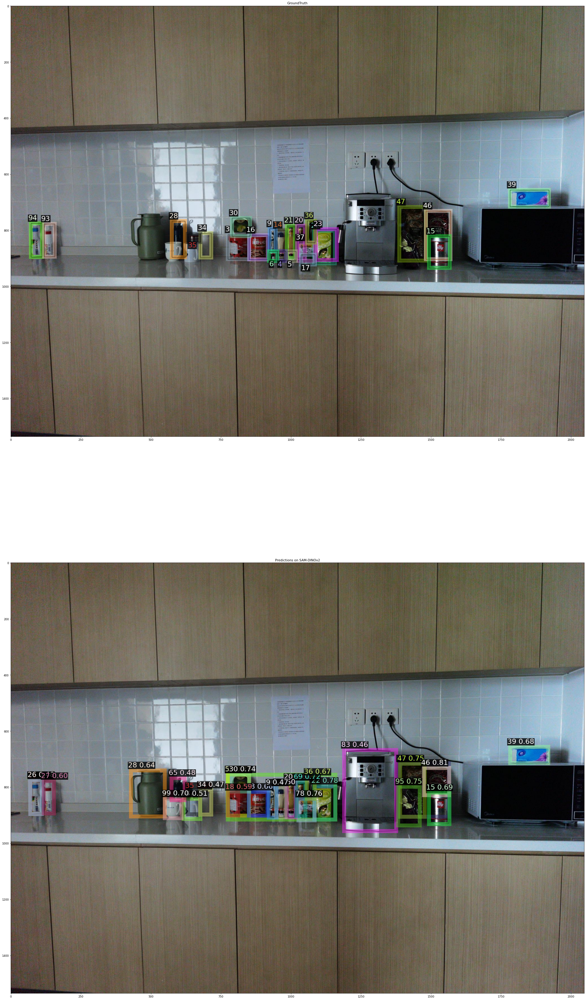

In [16]:
# In[12]:
fig = plt.figure(figsize=(30,60), dpi=64, facecolor='w', edgecolor='k')
ax = plt.subplot(211)
ax.set_title("GroundTruth")
plt.imshow(vis_gt.get_image()[:, :, :])
ax = plt.subplot(212)
ax.set_title("Predictions on SAM-DINOv2")
plt.imshow(vis_pred.get_image()[:, :, :])
plt.tight_layout()
# plt.savefig('./result_images/InsDet/'+base_name+'_SAM_DINOv2.png', dpi=300)
plt.show()